In [1]:
import cv2
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from matplotlib.colors import hsv_to_rgb
from sklearn.cluster import KMeans
from sklearn.metrics import adjusted_rand_score, silhouette_score

def compare_movie_colors_3d(trailer_name_list, n_clusters=2, resize_dim=(64, 36)):

    name = trailer_name_list[0]
    cap = cv2.VideoCapture(f'{trailer_name_list[0]}.mp4')
    average_colors_hsv = []

    while True:
        ret, frame = cap.read()
        if not ret:
            break
            
        frame = cv2.resize(frame, resize_dim) 
        rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
        rgb_normalized = rgb / 255.0  # Normalize to [0, 1]
        hsv = matplotlib.colors.rgb_to_hsv(rgb_normalized)
        avg_hsv = hsv.mean(axis=(0, 1))
        average_colors_hsv.append(avg_hsv)
    
    cap.release()

    movie1_hsv = np.array(average_colors_hsv)

    name = trailer_name_list[1]
    cap = cv2.VideoCapture(f'{name}.mp4')
    average_colors_hsv = []

    while True:
        ret, frame = cap.read()
        if not ret:
            break
    
            
        frame = cv2.resize(frame, resize_dim) 
        rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
        rgb_normalized = rgb / 255.0  # Normalize to [0, 1]
        hsv = matplotlib.colors.rgb_to_hsv(rgb_normalized)
        avg_hsv = hsv.mean(axis=(0, 1))
        average_colors_hsv.append(avg_hsv)
    
    cap.release()

    movie2_hsv = np.array(average_colors_hsv)

    
    # Combine data and true labels
    X = np.vstack([movie1_hsv, movie2_hsv])  # shape (N1+N2, 3)
    labels_true = np.array([0] * len(movie1_hsv) + [1] * len(movie2_hsv))

    # Run K-Means clustering
    kmeans = KMeans(n_clusters=n_clusters, random_state=0)
    cluster_labels = kmeans.fit_predict(X)

    # Calculate metrics
    ari = adjusted_rand_score(labels_true, cluster_labels)
    sil = silhouette_score(X, cluster_labels)
    print(f"Adjusted Rand Index: {ari:.3f}")
    print(f"Silhouette Score: {sil:.3f}")

    # Convert HSV to RGB for true color
    colors_rgb = hsv_to_rgb(X)

    # Plot: Cluster view
    fig = plt.figure(figsize=(14, 6))

    ax1 = fig.add_subplot(121, projection='3d')
    scatter1 = ax1.scatter(X[:, 0], X[:, 1], X[:, 2], c=cluster_labels, cmap='Set1', s=20)
    ax1.set_xlabel('Hue')
    ax1.set_ylabel('Saturation')
    ax1.set_zlabel('Value')
    ax1.set_title('K-Means Cluster Labels')

    # Plot: True movie source view
    ax2 = fig.add_subplot(122, projection='3d')
    scatter2 = ax2.scatter(X[:, 0], X[:, 1], X[:, 2], c=labels_true, cmap='coolwarm', s=20)
    ax2.set_xlabel('Hue')
    ax2.set_ylabel('Saturation')
    ax2.set_zlabel('Value')
    ax2.set_title('True Movie Source Labels')

    plt.tight_layout()
    plt.show()

In [2]:
def plot_movie_colors_3d(trailer_name_list, resize_dim=(64, 36)):

    fig = plt.figure(figsize=(10, 8))
    ax = fig.add_subplot(111, projection='3d')
    for name in trailer_name_list:
        cap = cv2.VideoCapture(f'{name}.mp4')
        average_colors_hsv = []

        while True:
            ret, frame = cap.read()
            if not ret:
                break

            frame = cv2.resize(frame, resize_dim) 
            rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
            rgb_normalized = rgb / 255.0  # Normalize to [0, 1]
            hsv = matplotlib.colors.rgb_to_hsv(rgb_normalized)
            avg_hsv = hsv.mean(axis=(0, 1))
            average_colors_hsv.append(avg_hsv)
        
        cap.release()
        
        
        average_colors_hsv = np.array(average_colors_hsv) #(no. of frames, 3) 
        h, s, v = average_colors_hsv[:, 0], average_colors_hsv[:, 1], average_colors_hsv[:, 2]
        colors_rgb = hsv_to_rgb(average_colors_hsv)

        ax.scatter(h, s, v, s=5, alpha=0.5, label=name)
        
    ax.set_xlabel("Hue")
    ax.set_ylabel("Saturation")
    ax.set_zlabel("Value")
    ax.set_title("Average HSV Color per Frame (Colored by HSV)")
    
    ax.legend()
    plt.tight_layout()
    plt.show()

def plot_movie_colors(trailer_name_list, resize_dim=(64, 36)):
    # Plotting
    fig, axs = plt.subplots(1, 3, figsize=(18, 5))
    for name in trailer_name_list:
        cap = cv2.VideoCapture(f'{name}.mp4')
        average_colors_hsv = []

        while True:
            ret, frame = cap.read()
            if not ret:
                break
            
                
            frame = cv2.resize(frame, resize_dim) 
            rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
            rgb_normalized = rgb / 255.0  # Normalize to [0, 1]
            hsv = matplotlib.colors.rgb_to_hsv(rgb_normalized)
            avg_hsv = hsv.mean(axis=(0, 1))
            average_colors_hsv.append(avg_hsv)
        
        cap.release()

        
        average_colors_hsv = np.array(average_colors_hsv) #(no. of frames, 3) 
        h, s, v = average_colors_hsv[:, 0], average_colors_hsv[:, 1], average_colors_hsv[:, 2]
        colors_rgb = hsv_to_rgb(average_colors_hsv)
        
        # Hue vs Saturation
        axs[0].scatter(h, s, s=2, label=name)
        axs[0].set_xlabel('Hue')
        axs[0].set_ylabel('Saturation')
        axs[0].set_title('Hue vs Saturation')
        
        # Hue vs Value
        axs[1].scatter(h, v, s=2, label=name)
        axs[1].set_xlabel('Hue')
        axs[1].set_ylabel('Value')
        axs[1].set_title('Hue vs Value')
        
        # Saturation vs Value
        axs[2].scatter(s, v, s=2, label=name)
        axs[2].set_xlabel('Saturation')
        axs[2].set_ylabel('Value')
        axs[2].set_title('Saturation vs Value')

    ax.legend()
    plt.suptitle(f"{name} Movie Trailer Color Distribution")
    plt.tight_layout()
    plt.show()

from sklearn.cluster import KMeans
from mpl_toolkits.mplot3d import Axes3D
from sklearn.metrics import adjusted_rand_score, silhouette_score

def compare_movie_colors_3d(trailer_name_list, n_clusters=2, resize_dim=(64, 36)):

    name = trailer_name_list[0]
    cap = cv2.VideoCapture(f'{name}.mp4')
    average_colors_hsv = []

    while True:
        ret, frame = cap.read()
        if not ret:
            break

        frame = cv2.resize(frame, resize_dim) 
        rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
        rgb_normalized = rgb / 255.0  # Normalize to [0, 1]
        hsv = matplotlib.colors.rgb_to_hsv(rgb_normalized)
        avg_hsv = hsv.mean(axis=(0, 1))
        average_colors_hsv.append(avg_hsv)
    
    cap.release()

    movie1_hsv = np.array(average_colors_hsv)


    name = trailer_name_list[1]
    cap = cv2.VideoCapture(f'{name}.mp4')
    average_colors_hsv = []

    while True:
        ret, frame = cap.read()
        if not ret:
            break
            
        frame = cv2.resize(frame, resize_dim) 
        rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
        rgb_normalized = rgb / 255.0  # Normalize to [0, 1]
        hsv = matplotlib.colors.rgb_to_hsv(rgb_normalized)
        avg_hsv = hsv.mean(axis=(0, 1))
        average_colors_hsv.append(avg_hsv)
    
    cap.release()

    movie2_hsv = np.array(average_colors_hsv)

    
    # Combine data and true labels
    X = np.vstack([movie1_hsv, movie2_hsv])  # shape (N1+N2, 3)
    labels_true = np.array([0] * len(movie1_hsv) + [1] * len(movie2_hsv))

    # Run K-Means clustering
    kmeans = KMeans(n_clusters=n_clusters, random_state=0)
    cluster_labels = kmeans.fit_predict(X)

    # Get the cluster centroids
    centroids = kmeans.cluster_centers_
    
    # Print the centroids
    print("centroids: ", centroids)
    
    # Calculate metrics
    ari = adjusted_rand_score(labels_true, cluster_labels)
    sil = silhouette_score(X, cluster_labels)
    print(f"Adjusted Rand Index: {ari:.3f}")
    print(f"Silhouette Score: {sil:.3f}")

    # Convert HSV to RGB for true color
    colors_rgb = hsv_to_rgb(X)

    # Plot: Cluster view
    fig = plt.figure(figsize=(14, 6))

    ax1 = fig.add_subplot(121, projection='3d')
    scatter1 = ax1.scatter(X[:, 0], X[:, 1], X[:, 2], c=cluster_labels, cmap='Set1', s=20, alpha=0.5)
    ax1.set_xlabel('Hue')
    ax1.set_ylabel('Saturation')
    ax1.set_zlabel('Value')
    ax1.set_title('K-Means Cluster Labels')
    

# Plot: True movie source view
    ax2 = fig.add_subplot(122, projection='3d')
    
    # Split by true labels for clarity and labeling
    for label_val, trailer_name in enumerate(trailer_name_list):
        trailer_points = X[labels_true == label_val]
        ax2.scatter(
            trailer_points[:, 0], trailer_points[:, 1], trailer_points[:, 2],
            label=trailer_name, s=20, alpha=0.5
        )
    
    ax2.set_xlabel('Hue')
    ax2.set_ylabel('Saturation')
    ax2.set_zlabel('Value')
    ax2.set_title('True Movie Source Labels')
    ax2.legend()


    ax1.set_box_aspect(None, zoom=0.85)
    ax2.set_box_aspect(None, zoom=0.85)
    
    plt.tight_layout()
    fig.show()

def get_rand_index(trailer_name_list, n_clusters=2, resize_dim=(64, 36)):

    name = trailer_name_list[0]
    cap = cv2.VideoCapture(f'{name}.mp4')
    average_colors_hsv = []

    while True:
        ret, frame = cap.read()
        if not ret:
            break
            
            
        frame = cv2.resize(frame, resize_dim) 
        rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
        rgb_normalized = rgb / 255.0  # Normalize to [0, 1]
        hsv = matplotlib.colors.rgb_to_hsv(rgb_normalized)
        avg_hsv = hsv.mean(axis=(0, 1))
        average_colors_hsv.append(avg_hsv)
    
    cap.release()

    movie1_hsv = np.array(average_colors_hsv)

    name = trailer_name_list[1]
    cap = cv2.VideoCapture(f'{name}.mp4')
    average_colors_hsv = []

    while True:
        ret, frame = cap.read()
        if not ret:
            break

        frame = cv2.resize(frame, resize_dim) 
        rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
        rgb_normalized = rgb / 255.0  # Normalize to [0, 1]
        hsv = matplotlib.colors.rgb_to_hsv(rgb_normalized)
        avg_hsv = hsv.mean(axis=(0, 1))
        average_colors_hsv.append(avg_hsv)
    
    cap.release()

    movie2_hsv = np.array(average_colors_hsv)

    
    # Combine data and true labels
    X = np.vstack([movie1_hsv, movie2_hsv])  # shape (N1+N2, 3)
    labels_true = np.array([0] * len(movie1_hsv) + [1] * len(movie2_hsv))

    # Run K-Means clustering
    kmeans = KMeans(n_clusters=n_clusters, random_state=0)
    cluster_labels = kmeans.fit_predict(X)

    # Calculate metrics
    ari = adjusted_rand_score(labels_true, cluster_labels)
    return ari

centroids:  [[0.53366399 0.44835296 0.51048145]
 [0.22374436 0.2307578  0.24903524]]
Adjusted Rand Index: 0.021
Silhouette Score: 0.364


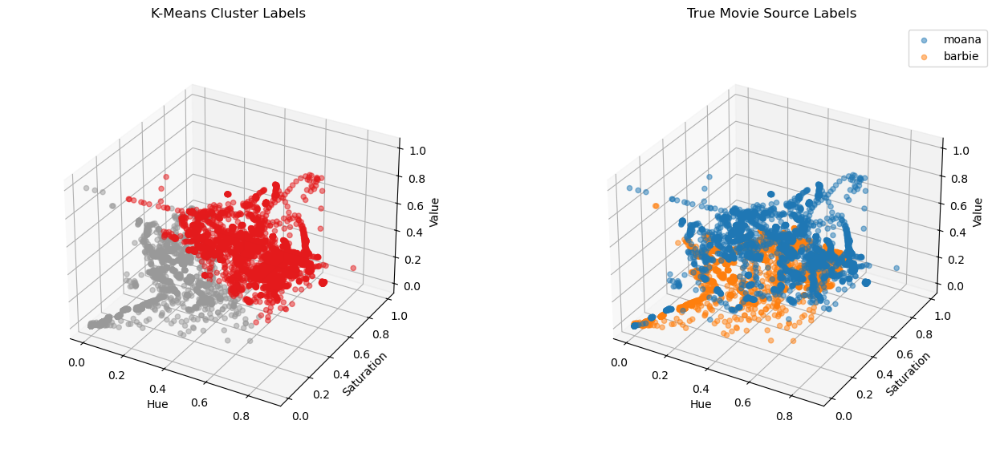

In [3]:
trailer_name_list = ['moana', 'barbie']
compare_movie_colors_3d(trailer_name_list, resize_dim=(64, 36))

In [ ]:
movie_list = ['lalaland', 'madmax', 'thegreatgatsby', 'shawshank', 'elemental', 'inside out', 'moana', 'soul']

rand_indices = [[get_rand_index([x, y]) for y in movie_list] for x in movie_list]

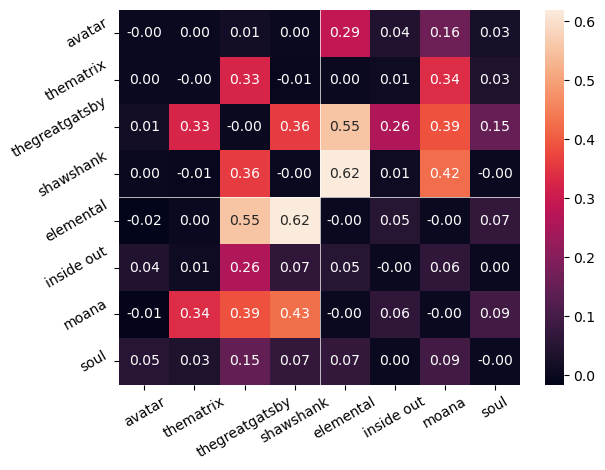

In [8]:
import pandas as pd
import seaborn as sns
data = np.array(rand_indices)


# Create DataFrame
df = pd.DataFrame(data, index=movie_list, columns=movie_list)

fig, ax = plt.subplots()
ax = sns.heatmap(df, annot=True, fmt=".2f")
ax.tick_params(axis='x', rotation=30)
ax.tick_params(axis='y', rotation=30)
ax.axhline(y=4, color='white', linewidth=0.5)
ax.axvline(x=4, color='white', linewidth=0.5)
fig.tight_layout()
fig.show()

In [10]:
def extract_avg_hsv(name, resize_dim=(64, 36), frame_skip=1):
    cap = cv2.VideoCapture(f'{name}.mp4')
    average_colors_hsv = []
    frame_idx = 0

    while True:
        ret, frame = cap.read()
        if not ret:
            break

        if frame_idx % frame_skip == 0:
            frame = cv2.resize(frame, resize_dim) 
            rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
            rgb_normalized = rgb / 255.0
            hsv = matplotlib.colors.rgb_to_hsv(rgb_normalized)
            avg_hsv = hsv.mean(axis=(0, 1))
            average_colors_hsv.append(avg_hsv)

        frame_idx += 1
    
    cap.release()
    return np.array(average_colors_hsv)

def compare_genre_colors_3d(genre_dict, n_clusters=2, resize_dim=(64, 36), frame_skip=1):
    X = []
    labels_true = []
    genre_names = list(genre_dict.keys())

    for i, genre_name in enumerate(genre_names):
        for trailer_name in genre_dict[genre_name]:
            hsv_values = extract_avg_hsv(trailer_name, resize_dim, frame_skip)
            X.append(hsv_values)
            labels_true.extend([i] * len(hsv_values))

    X = np.vstack(X)
    labels_true = np.array(labels_true)

    # Clustering
    kmeans = KMeans(n_clusters=n_clusters, random_state=0)
    cluster_labels = kmeans.fit_predict(X)

    # Metrics
    ari = adjusted_rand_score(labels_true, cluster_labels)
    sil = silhouette_score(X, cluster_labels)
    print(f"Adjusted Rand Index: {ari:.3f}")
    print(f"Silhouette Score: {sil:.3f}")

    # Visualization
    fig = plt.figure(figsize=(14, 6))

    ax1 = fig.add_subplot(121, projection='3d')
    ax1.scatter(X[:, 0], X[:, 1], X[:, 2], c=cluster_labels, cmap='Set1', s=20, alpha=0.5)
    ax1.set_xlabel('Hue')
    ax1.set_ylabel('Saturation')
    ax1.set_zlabel('Value')
    ax1.set_title('K-Means Cluster Labels')

    ax2 = fig.add_subplot(122, projection='3d')
    for i, genre_name in enumerate(genre_names):
        points = X[labels_true == i]
        ax2.scatter(points[:, 0], points[:, 1], points[:, 2], label=genre_name, s=20, alpha=0.5)

    ax2.set_xlabel('Hue')
    ax2.set_ylabel('Saturation')
    ax2.set_zlabel('Value')
    ax2.set_title('True Genre Labels')
    ax2.legend()

    plt.tight_layout()
    fig.show()

Adjusted Rand Index: 0.187
Silhouette Score: 0.306


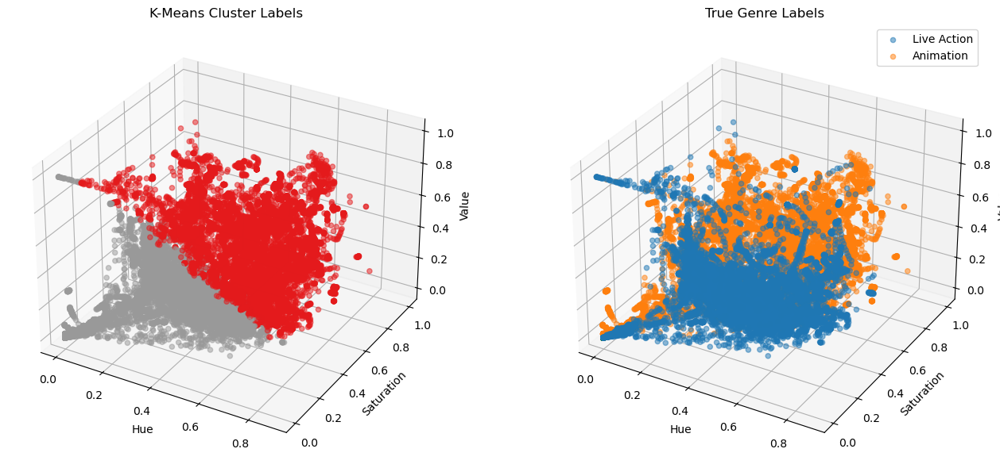

In [11]:
genre_dict = {
    "Live Action": ['avatar', 'thematrix', 'thegreatgatsby', 'shawshank'], 
    "Animation": ['elemental', 'inside out', 'moana', 'soul']
}

compare_genre_colors_3d(genre_dict)

In [13]:
from mpl_toolkits.mplot3d import Axes3D
from matplotlib.colors import hsv_to_rgb

def extract_avg_hsv(video_path, resize_dim=(64, 36), frame_skip=1):
    cap = cv2.VideoCapture(video_path)
    average_colors_hsv = []
    frame_idx = 0

    while True:
        ret, frame = cap.read()
        if not ret:
            break

        if frame_idx % frame_skip == 0:
            frame = cv2.resize(frame, resize_dim) 
            rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
            rgb_normalized = rgb / 255.0
            hsv = matplotlib.colors.rgb_to_hsv(rgb_normalized)
            avg_hsv = hsv.mean(axis=(0, 1))
            average_colors_hsv.append(avg_hsv)

        frame_idx += 1
    
    cap.release()
    return np.array(average_colors_hsv)

def compare_genre_colors_3d(genre_dict, n_clusters=2, resize_dim=(64, 36), frame_skip=1, auto_k=False, k_max=20):
    X = []
    labels_true = []
    genre_names = list(genre_dict.keys())

    for i, genre_name in enumerate(genre_names):
        for trailer_name in genre_dict[genre_name]:
            hsv_values = extract_avg_hsv(f'{trailer_name}.mp4', resize_dim, frame_skip)
            X.append(hsv_values)
            labels_true.extend([i] * len(hsv_values))

    X = np.vstack(X)
    labels_true = np.array(labels_true)

    # Optional: Elbow method to find optimal k
    if auto_k:
        inertias = []
        k_range = range(1, k_max + 1)
        for k in k_range:
            km = KMeans(n_clusters=k, random_state=0)
            km.fit(X)
            inertias.append(km.inertia_)

        # Plot the elbow curve
        plt.figure()
        plt.plot(k_range, inertias, marker='o')
        plt.xlabel("Number of Clusters (k)")
        plt.ylabel("Inertia")
        plt.title(f"Elbow Method for {genre_dict[genre_names[0]][0]}, {genre_dict[genre_names[1]][0]}")
        #plt.title(f"Elbow Method for {genre_dict[genre_names[0]][0]}")
        plt.xticks(k_range)
        plt.grid(True)
        plt.show()

        # Ask user to manually pick k after viewing plot
        print("Check the Elbow plot and set the best k using the `n_clusters` argument.")
        return

    # Clustering
    kmeans = KMeans(n_clusters=n_clusters, random_state=0)
    cluster_labels = kmeans.fit_predict(X)

    # Metrics
    ari = adjusted_rand_score(labels_true, cluster_labels)
    sil = silhouette_score(X, cluster_labels)
    print(f"Adjusted Rand Index: {ari:.3f}")
    print(f"Silhouette Score: {sil:.3f}")

    # Visualization
    fig = plt.figure(figsize=(14, 6))

    ax1 = fig.add_subplot(121, projection='3d')
    ax1.scatter(X[:, 0], X[:, 1], X[:, 2], c=cluster_labels, cmap='Set1', s=20)
    ax1.set_xlabel('Hue')
    ax1.set_ylabel('Saturation')
    ax1.set_zlabel('Value')
    ax1.set_title('K-Means Cluster Labels')

    ax2 = fig.add_subplot(122, projection='3d')
    for i, genre_name in enumerate(genre_names):
        points = X[labels_true == i]
        ax2.scatter(points[:, 0], points[:, 1], points[:, 2], label=genre_name, s=20)

    ax2.set_xlabel('Hue')
    ax2.set_ylabel('Saturation')
    ax2.set_zlabel('Value')
    ax2.set_title('True Genre Labels')
    ax2.legend()

    plt.tight_layout()
    plt.show()


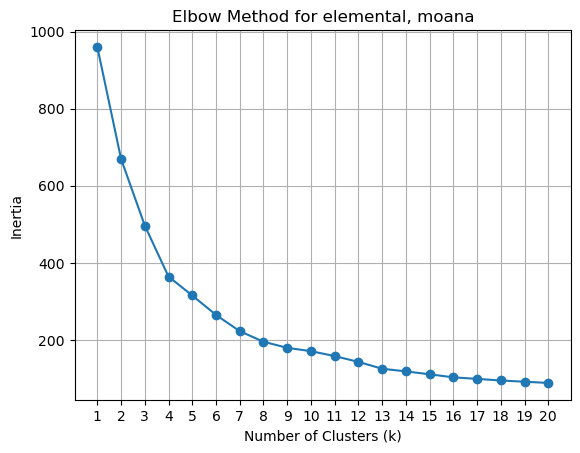

Check the Elbow plot and set the best k using the `n_clusters` argument.
Adjusted Rand Index: 0.074
Silhouette Score: 0.356


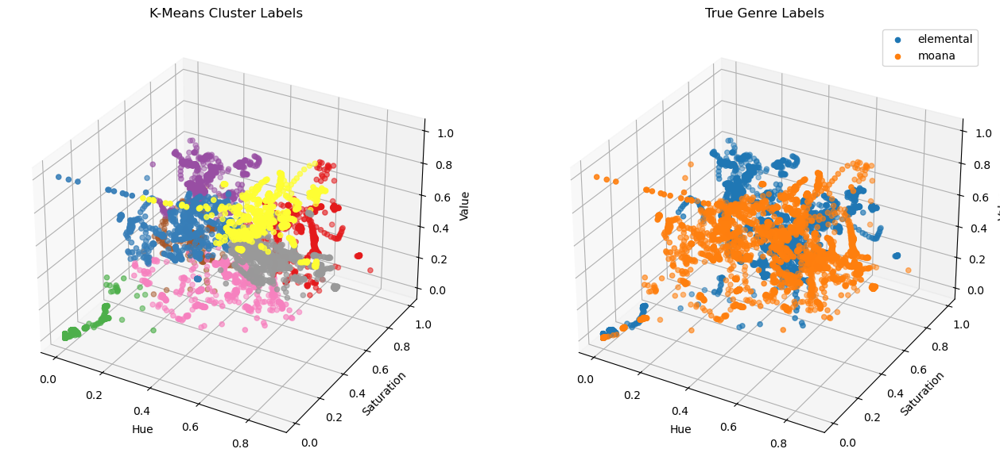

In [14]:
genre_dict = {
    "elemental": ["elemental"] ,
    "moana": ["moana"]
}

# Step 1: Use elbow method to find optimal k
compare_genre_colors_3d(genre_dict, auto_k=True)

# Step 2: Set best k manually based on plot
compare_genre_colors_3d(genre_dict, n_clusters=8)

In [15]:
import cv2
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from matplotlib.colors import hsv_to_rgb
from sklearn.cluster import KMeans
from sklearn.metrics import adjusted_rand_score, silhouette_score
from scipy.spatial.distance import cdist

def extract_avg_hsv_with_metadata(trailer_name, resize_dim=(64, 36), frame_skip=1):
    cap = cv2.VideoCapture(f"{trailer_name}.mp4")
    average_colors_hsv = []
    frame_indices = []
    frame_idx = 0

    while True:
        ret, frame = cap.read()
        if not ret:
            break

        if frame_idx % frame_skip == 0:
            frame_resized = cv2.resize(frame, resize_dim) 
            rgb = cv2.cvtColor(frame_resized, cv2.COLOR_BGR2RGB)
            rgb_normalized = rgb / 255.0
            hsv = matplotlib.colors.rgb_to_hsv(rgb_normalized)
            avg_hsv = hsv.mean(axis=(0, 1))
            average_colors_hsv.append(avg_hsv)
            frame_indices.append(frame_idx)
        
        frame_idx += 1
    
    cap.release()
    return np.array(average_colors_hsv), frame_indices, [trailer_name] * len(frame_indices)

def show_frame(trailer_name, frame_index):
    cap = cv2.VideoCapture(f"{trailer_name}.mp4")
    cap.set(cv2.CAP_PROP_POS_FRAMES, frame_index)
    ret, frame = cap.read()
    cap.release()
    if ret:
        rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
        plt.imshow(rgb)
        plt.axis('off')
        plt.title(f"{trailer_name} — Frame {frame_index}")
        plt.show()
    else:
        print(f"Could not retrieve frame {frame_index} from {trailer_name}.")

def compare_genre_colors_with_representative_frames(genre_dict, n_clusters=3, resize_dim=(64, 36), frame_skip=1):
    X = []
    labels_true = []
    frame_meta = []  # [(trailer_name, frame_index)]
    genre_names = list(genre_dict.keys())

    for i, genre_name in enumerate(genre_names):
        for trailer_name in genre_dict[genre_name]:
            hsv_values, indices, names = extract_avg_hsv_with_metadata(trailer_name, resize_dim, frame_skip)
            X.append(hsv_values)
            labels_true.extend([i] * len(hsv_values))
            frame_meta.extend(list(zip(names, indices)))

    X = np.vstack(X)
    labels_true = np.array(labels_true)

    # Clustering
    kmeans = KMeans(n_clusters=n_clusters, random_state=0)
    cluster_labels = kmeans.fit_predict(X)

    # Metrics
    ari = adjusted_rand_score(labels_true, cluster_labels)
    sil = silhouette_score(X, cluster_labels)
    print(f"Adjusted Rand Index: {ari:.3f}")
    print(f"Silhouette Score: {sil:.3f}")

    # Visualization
    fig = plt.figure(figsize=(14, 6))
    ax1 = fig.add_subplot(121, projection='3d')
    ax1.scatter(X[:, 0], X[:, 1], X[:, 2], c=cluster_labels, cmap='Set1', s=20)
    ax1.set_title('K-Means Cluster Labels')
    ax1.set_xlabel('Hue')
    ax1.set_ylabel('Saturation')
    ax1.set_zlabel('Value')

    ax2 = fig.add_subplot(122, projection='3d')
    for i, genre_name in enumerate(genre_names):
        points = X[labels_true == i]
        ax2.scatter(points[:, 0], points[:, 1], points[:, 2], label=genre_name, s=20)
    ax2.set_title('True Genre Labels')
    ax2.set_xlabel('Hue')
    ax2.set_ylabel('Saturation')
    ax2.set_zlabel('Value')
    ax2.legend()

    plt.tight_layout()
    plt.show()

    # Pick a representative frame from each cluster
    for k in range(n_clusters):
        cluster_points = X[cluster_labels == k]
        cluster_indices = np.where(cluster_labels == k)[0]

        center = kmeans.cluster_centers_[k].reshape(1, -1)
        dists = cdist(cluster_points, center)
        closest_idx = cluster_indices[np.argmin(dists)]

        trailer_name, frame_idx = frame_meta[closest_idx]
        print(f"Cluster {k}: {trailer_name} — Frame {frame_idx}")
        show_frame(trailer_name, frame_idx)


Adjusted Rand Index: 0.187
Silhouette Score: 0.306


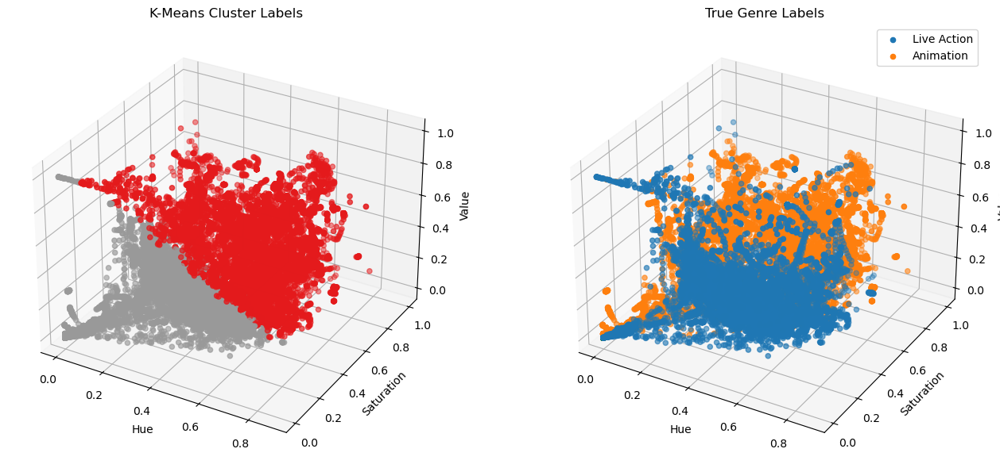

In [16]:
genre_dict = {
    "Live Action": ['avatar', 'thematrix', 'thegreatgatsby', 'shawshank'], 
    "Animation": ['elemental', 'inside out', 'moana', 'soul']
}

compare_genre_colors_3d(genre_dict)


Adjusted Rand Index: 0.619
Silhouette Score: 0.391


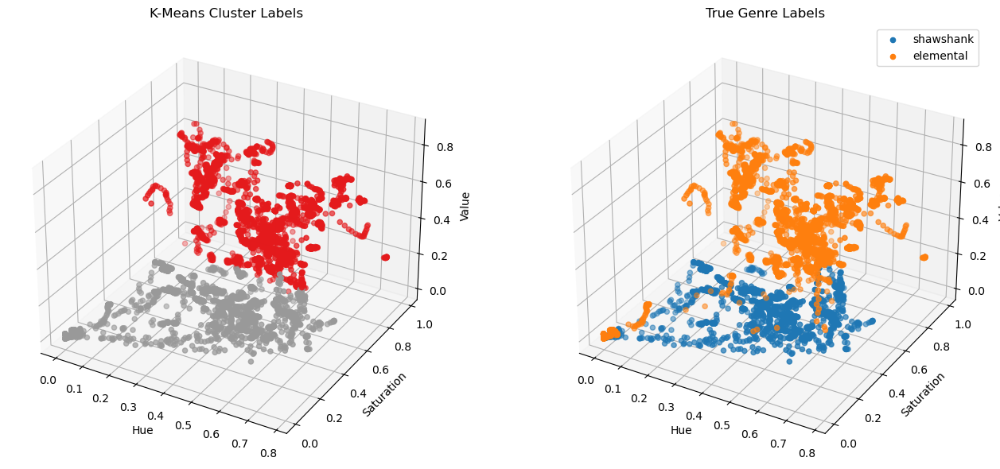

Cluster 0: elemental — Frame 1098


[h264 @ 0x58ec802ec6c0] mmco: unref short failure


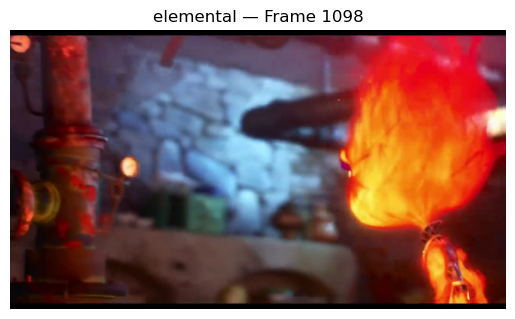

Cluster 1: shawshank — Frame 1569


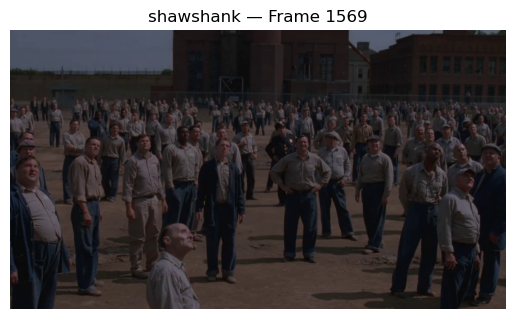

In [17]:
genre_dict = {
    "shawshank": ["shawshank"],
    "elemental": ["elemental"]
}

compare_genre_colors_with_representative_frames(genre_dict, n_clusters=2)


In [18]:
import cv2
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
from matplotlib.colors import hsv_to_rgb
from sklearn.cluster import KMeans
from sklearn.metrics import adjusted_rand_score, silhouette_score
from scipy.spatial.distance import cdist

def extract_avg_hsv_with_metadata(trailer_name, resize_dim=(64, 36), frame_skip=1):
    cap = cv2.VideoCapture(f"{trailer_name}.mp4")
    average_colors_hsv = []
    frame_indices = []
    frame_idx = 0

    while True:
        ret, frame = cap.read()
        if not ret:
            break

        if frame_idx % frame_skip == 0:
            frame_resized = cv2.resize(frame, resize_dim) 
            rgb = cv2.cvtColor(frame_resized, cv2.COLOR_BGR2RGB)
            rgb_normalized = rgb / 255.0
            hsv = matplotlib.colors.rgb_to_hsv(rgb_normalized)
            avg_hsv = hsv.mean(axis=(0, 1))
            average_colors_hsv.append(avg_hsv)
            frame_indices.append(frame_idx)
        
        frame_idx += 1
    
    cap.release()
    return np.array(average_colors_hsv), frame_indices, [trailer_name] * len(frame_indices)

def show_frame(trailer_name, frame_index):
    cap = cv2.VideoCapture(f"{trailer_name}.mp4")
    cap.set(cv2.CAP_PROP_POS_FRAMES, frame_index)
    ret, frame = cap.read()
    cap.release()
    if ret:
        rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
        plt.imshow(rgb)
        plt.axis('off')
        plt.title(f"{trailer_name} — Frame {frame_index}")
        plt.show()
    else:
        print(f"Could not retrieve frame {frame_index} from {trailer_name}.")

def compare_two_movies_clusters(trailer1, trailer2, n_clusters=3, resize_dim=(64, 36), frame_skip=1):
    # Load data from both movies
    data1, idx1, names1 = extract_avg_hsv_with_metadata(trailer1, resize_dim, frame_skip)
    data2, idx2, names2 = extract_avg_hsv_with_metadata(trailer2, resize_dim, frame_skip)

    X = np.vstack([data1, data2])
    labels_true = np.array([0] * len(data1) + [1] * len(data2))
    frame_meta = list(zip(names1 + names2, idx1 + idx2))

    # Run KMeans
    kmeans = KMeans(n_clusters=n_clusters, random_state=0)
    cluster_labels = kmeans.fit_predict(X)

    # Metrics
    ari = adjusted_rand_score(labels_true, cluster_labels)
    sil = silhouette_score(X, cluster_labels)
    print(f"Adjusted Rand Index: {ari:.3f}")
    print(f"Silhouette Score: {sil:.3f}")

    # Show representative frame from each movie per cluster
    for k in range(n_clusters):
        cluster_indices = np.where(cluster_labels == k)[0]
        print(f"\nCluster {k}:")

        for trailer in [trailer1, trailer2]:
            indices = [i for i in cluster_indices if frame_meta[i][0] == trailer]
            if indices:
                dists = cdist(X[indices], kmeans.cluster_centers_[k].reshape(1, -1))
                closest_idx = indices[np.argmin(dists)]
                trailer_name, frame_index = frame_meta[closest_idx]
                hsv_val = X[closest_idx]
                print(f"  {trailer_name} — Frame {frame_index} — HSV: {hsv_val}")
                show_frame(trailer_name, frame_index)
            else:
                print(f"  {trailer}: No frames in this cluster.")



Adjusted Rand Index: 0.099
Silhouette Score: 0.409

Cluster 0:
  elemental — Frame 1706 — HSV: [0.29067888 0.392725   0.23909314]


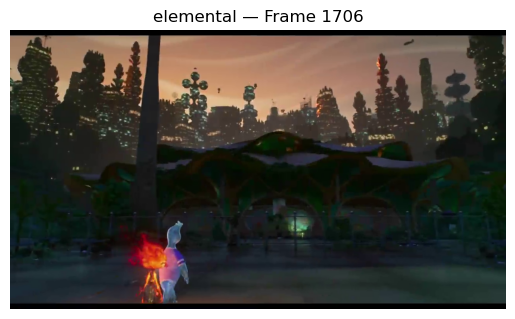

  soul — Frame 2643 — HSV: [0.26066702 0.41403533 0.29576695]


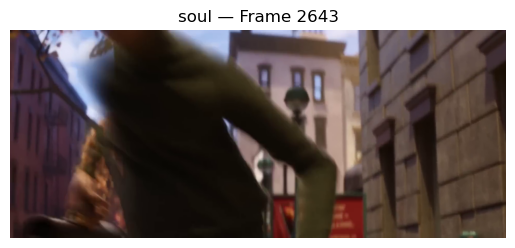


Cluster 1:
  elemental — Frame 2010 — HSV: [0.02548896 0.03779034 0.02838031]


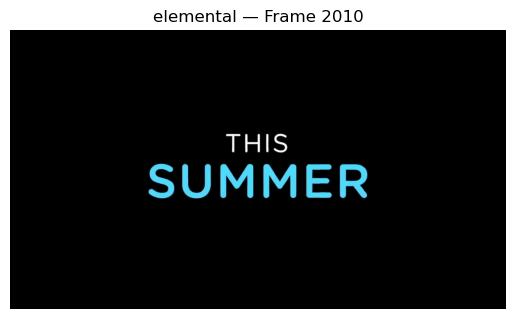

  soul — Frame 2914 — HSV: [0.06787817 0.09459342 0.07844839]


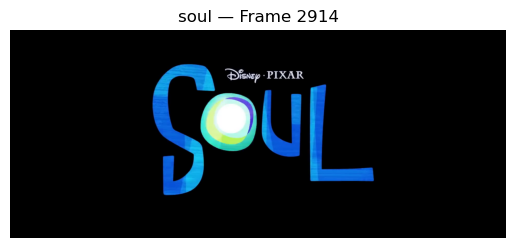


Cluster 2:
  elemental — Frame 861 — HSV: [0.21224059 0.73076978 0.62522808]


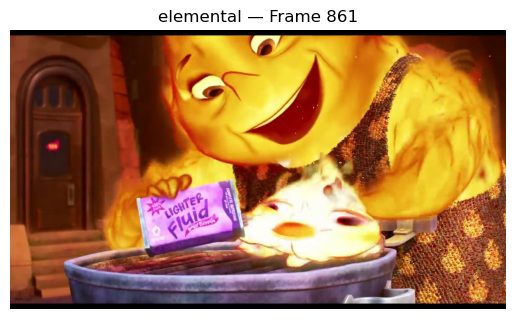

  soul — Frame 651 — HSV: [0.18476814 0.62884576 0.41171705]


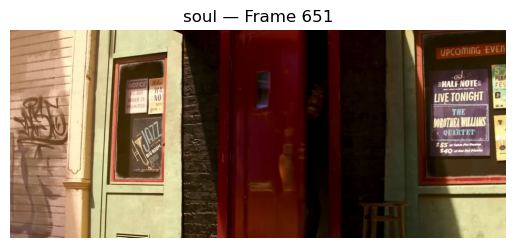


Cluster 3:
  elemental — Frame 1235 — HSV: [0.5938933  0.35834095 0.62281454]


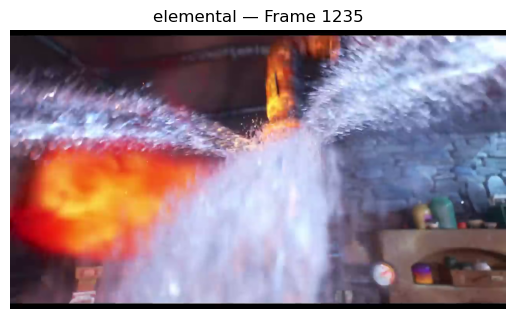

  soul — Frame 2465 — HSV: [0.62535408 0.31082896 0.62686377]


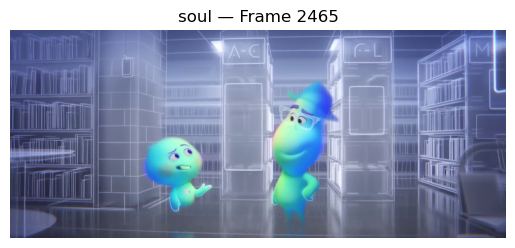


Cluster 4:
  elemental — Frame 2584 — HSV: [0.64730203 0.73328897 0.60422794]


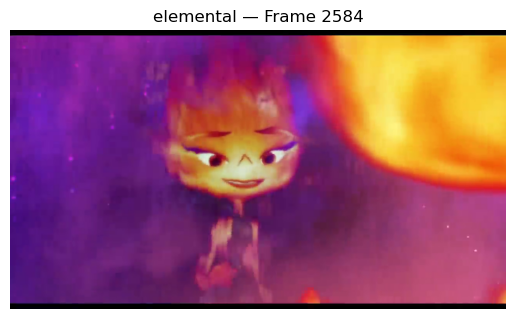

  soul — Frame 2776 — HSV: [0.62315369 0.74070901 0.6244247 ]


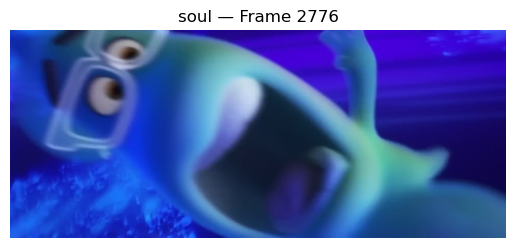


Cluster 5:
  elemental — Frame 1201 — HSV: [0.55826912 0.64160275 0.33353588]


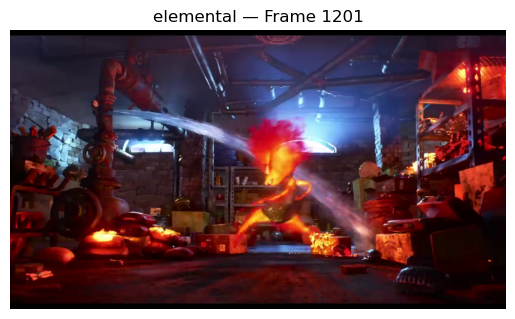

  soul — Frame 2320 — HSV: [0.58827818 0.63004825 0.31900871]


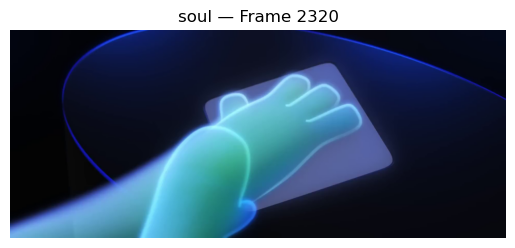


Cluster 6:
  elemental — Frame 653 — HSV: [0.53944441 0.47135085 0.47760587]


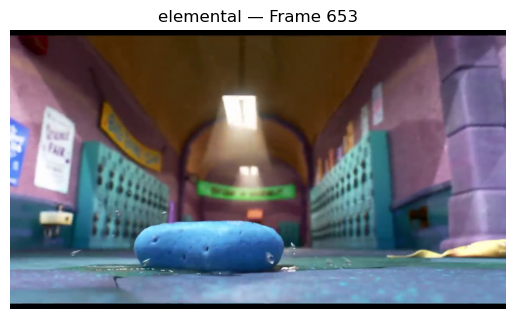

  soul — Frame 2589 — HSV: [0.57230165 0.33134369 0.4184198 ]


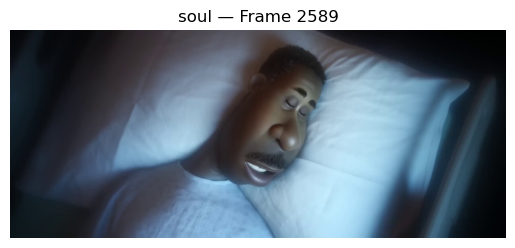


Cluster 7:
  elemental — Frame 448 — HSV: [0.14257907 0.74695657 0.21690836]


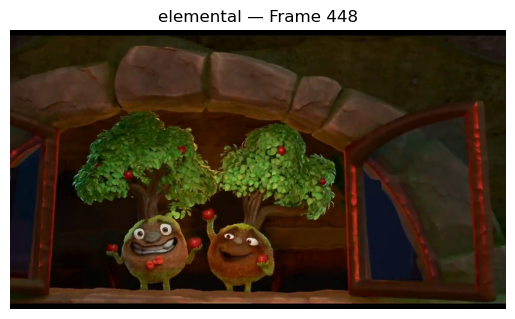

  soul — Frame 672 — HSV: [0.14428841 0.7766066  0.29825027]


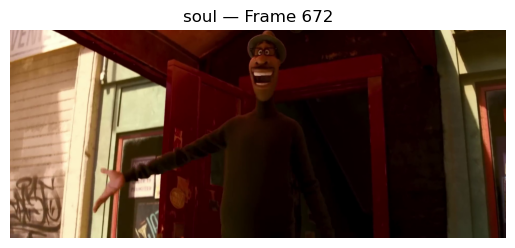

In [19]:
compare_two_movies_clusters("elemental", "soul", n_clusters=8)

In [20]:
import cv2
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
from matplotlib.colors import hsv_to_rgb
from sklearn.cluster import KMeans
from sklearn.metrics import adjusted_rand_score, silhouette_score
from scipy.spatial.distance import cdist

def extract_avg_hsv_with_metadata(trailer_name, resize_dim=(64, 36), frame_skip=1):
    cap = cv2.VideoCapture(f"{trailer_name}.mp4")
    average_colors_hsv = []
    frame_indices = []
    frame_idx = 0

    while True:
        ret, frame = cap.read()
        if not ret:
            break

        if frame_idx % frame_skip == 0:
            frame_resized = cv2.resize(frame, resize_dim) 
            rgb = cv2.cvtColor(frame_resized, cv2.COLOR_BGR2RGB)
            rgb_normalized = rgb / 255.0
            hsv = matplotlib.colors.rgb_to_hsv(rgb_normalized)
            avg_hsv = hsv.mean(axis=(0, 1))
            average_colors_hsv.append(avg_hsv)
            frame_indices.append(frame_idx)
        
        frame_idx += 1
    
    cap.release()
    return np.array(average_colors_hsv), frame_indices, [trailer_name] * len(frame_indices)

def show_frame_with_hsv(trailer_name, frame_index, hsv_val, cluster):
    cap = cv2.VideoCapture(f"{trailer_name}.mp4")
    cap.set(cv2.CAP_PROP_POS_FRAMES, frame_index)
    ret, frame = cap.read()
    cap.release()
    
    if ret:
        rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
        color_rgb = hsv_to_rgb(np.array(hsv_val).reshape(1, 1, 3)).squeeze()

        fig, axs = plt.subplots(1, 2, figsize=(8, 4))
        axs[0].imshow(rgb)
        axs[0].axis('off')
        axs[0].set_title(f"{trailer_name}\nFrame {frame_index}")

        axs[1].imshow(np.ones((100, 100, 3)) * color_rgb)
        axs[1].axis('off')
        axs[1].set_title(f"HSV: {np.round(hsv_val, 3)}")

        plt.tight_layout()
        plt.show()
    else:
        print(f"Could not retrieve frame {frame_index} from {trailer_name}.")


def compare_two_movies_clusters(trailer1, trailer2, n_clusters=3, resize_dim=(64, 36), frame_skip=1):
    # Load data from both movies
    data1, idx1, names1 = extract_avg_hsv_with_metadata(trailer1, resize_dim, frame_skip)
    data2, idx2, names2 = extract_avg_hsv_with_metadata(trailer2, resize_dim, frame_skip)

    X = np.vstack([data1, data2])
    labels_true = np.array([0] * len(data1) + [1] * len(data2))
    frame_meta = list(zip(names1 + names2, idx1 + idx2))

    # Run KMeans
    kmeans = KMeans(n_clusters=n_clusters, random_state=0)
    cluster_labels = kmeans.fit_predict(X)

    # Metrics
    ari = adjusted_rand_score(labels_true, cluster_labels)
    sil = silhouette_score(X, cluster_labels)
    print(f"Adjusted Rand Index: {ari:.3f}")
    print(f"Silhouette Score: {sil:.3f}")

    # Show representative frame from each movie per cluster
    for k in range(n_clusters):
        cluster_indices = np.where(cluster_labels == k)[0]
        print(f"\nCluster {k}:")

        for trailer in [trailer1, trailer2]:
            indices = [i for i in cluster_indices if frame_meta[i][0] == trailer]
            if indices:
                dists = cdist(X[indices], kmeans.cluster_centers_[k].reshape(1, -1))
                closest_idx = indices[np.argmin(dists)]
                trailer_name, frame_index = frame_meta[closest_idx]
                hsv_val = X[closest_idx]
                print(f"  {trailer_name} — Frame {frame_index} — HSV: {hsv_val}")
                show_frame_with_hsv(trailer_name, frame_index, hsv_val, cluster=k)
            else:
                print(f"  {trailer}: No frames in this cluster.")



Adjusted Rand Index: 0.040
Silhouette Score: 0.365

Cluster 0:
  frozen — Frame 2139 — HSV: [0.71816664 0.44519346 0.63452819]


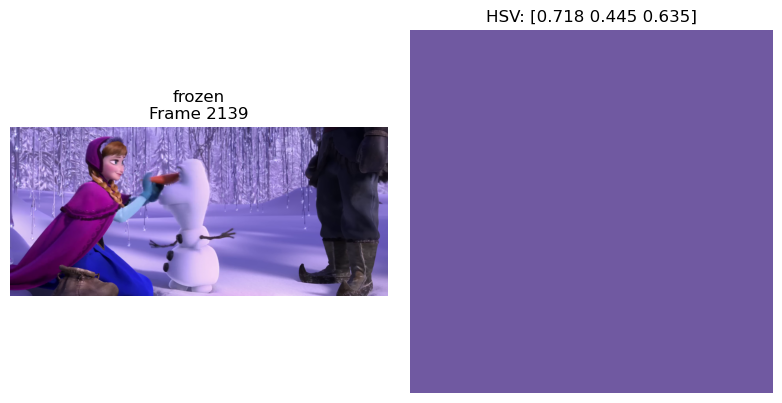

  moana — Frame 1827 — HSV: [0.71333896 0.46240465 0.57250647]


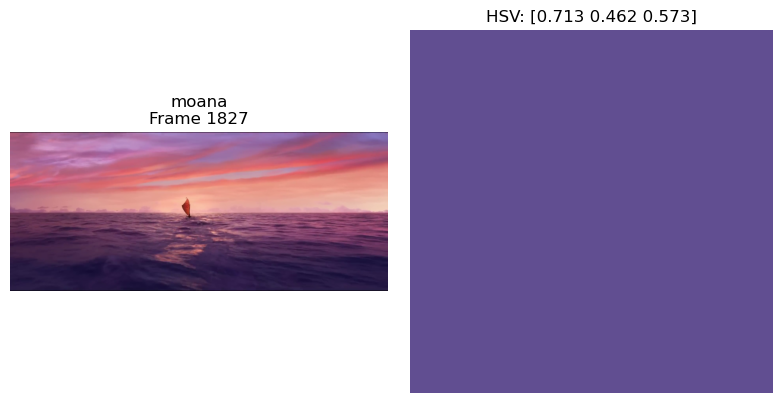


Cluster 1:
  frozen — Frame 3571 — HSV: [0.05086525 0.05603123 0.02342048]


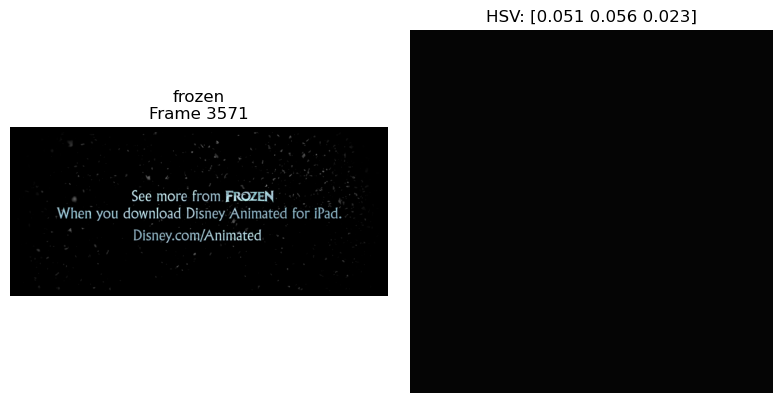

  moana — Frame 3411 — HSV: [0.04349956 0.06893274 0.02974707]


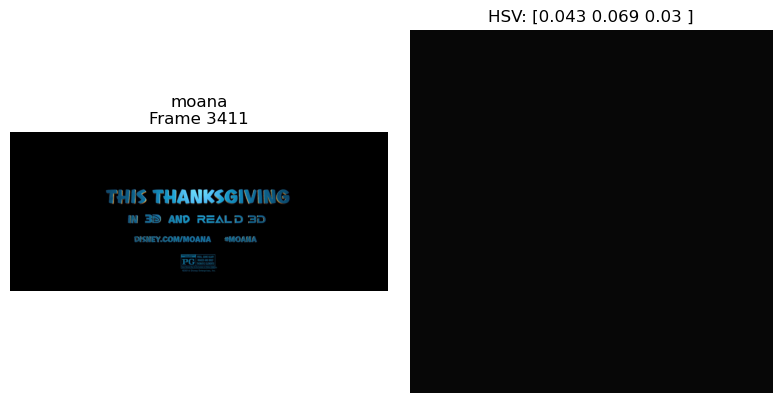


Cluster 2:
  frozen — Frame 571 — HSV: [0.60351915 0.84601002 0.37593444]


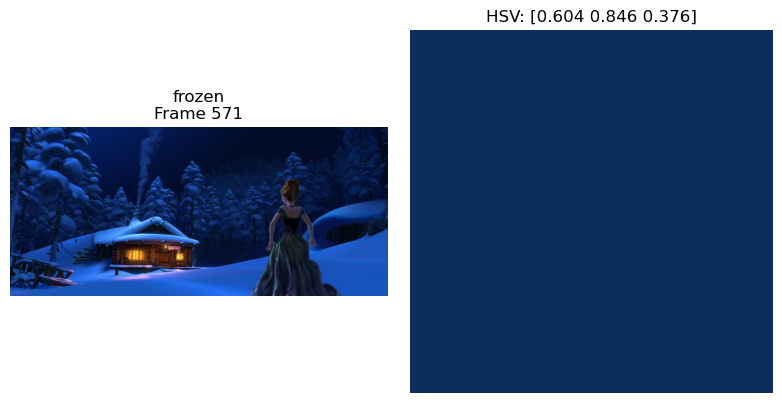

  moana — Frame 1083 — HSV: [0.57000251 0.91588333 0.31880276]


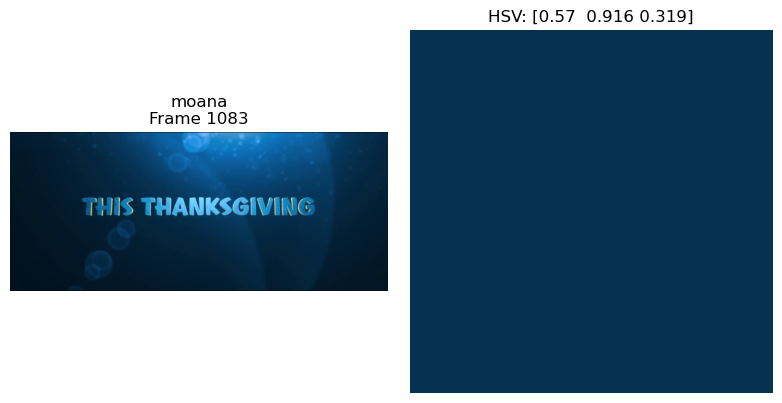


Cluster 3:
  frozen — Frame 3193 — HSV: [0.26126782 0.42263008 0.2594567 ]


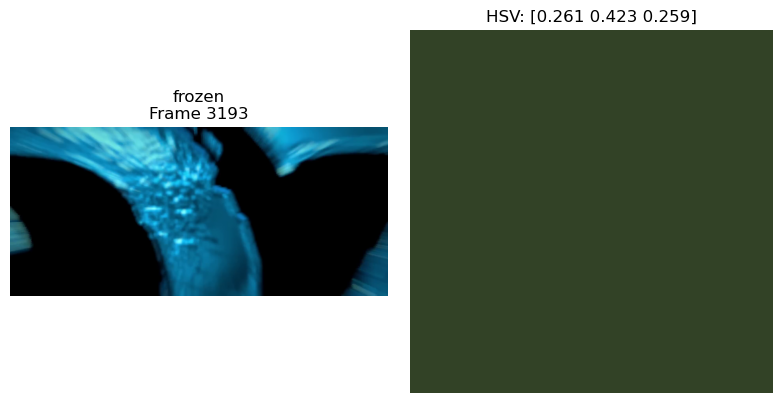

  moana — Frame 475 — HSV: [0.27919225 0.45798408 0.35281693]


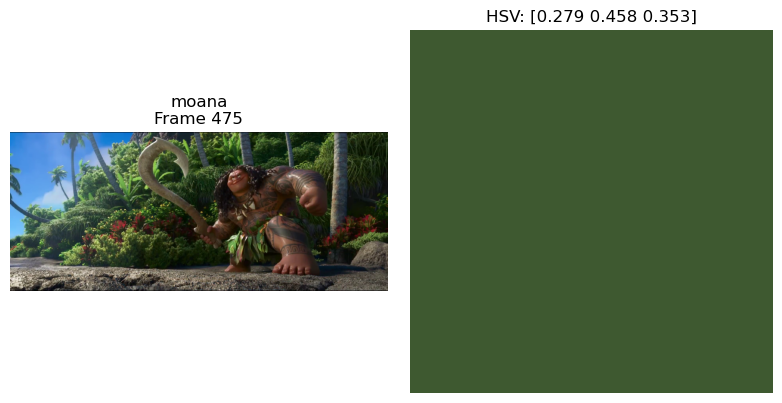


Cluster 4:
  frozen — Frame 1729 — HSV: [0.50832887 0.59675663 0.11051879]


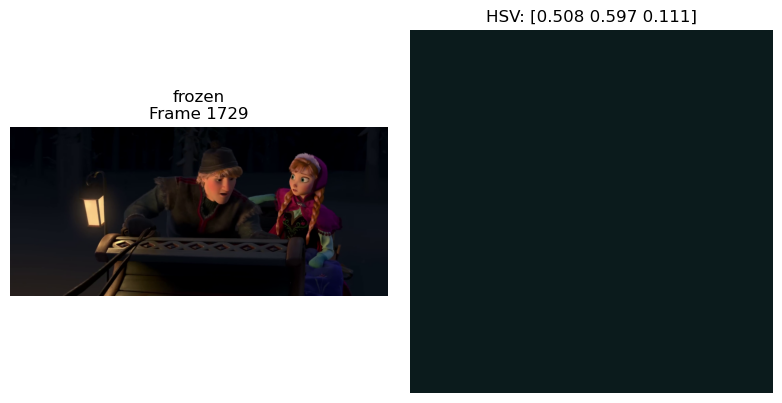

  moana — Frame 509 — HSV: [0.51317126 0.59971666 0.16559436]


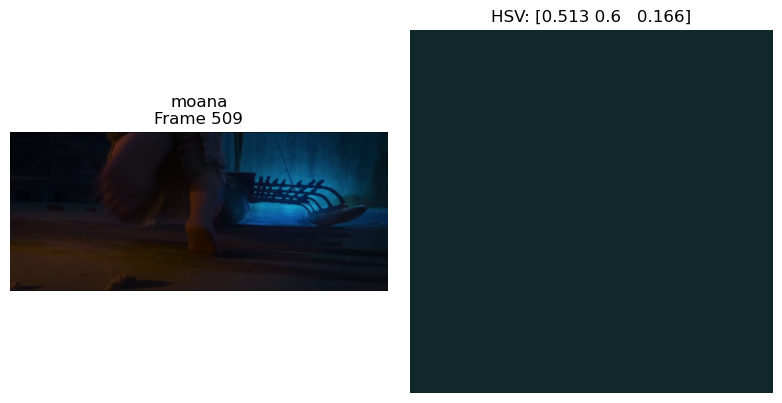


Cluster 5:
  frozen — Frame 1162 — HSV: [0.43832448 0.50116417 0.60268757]


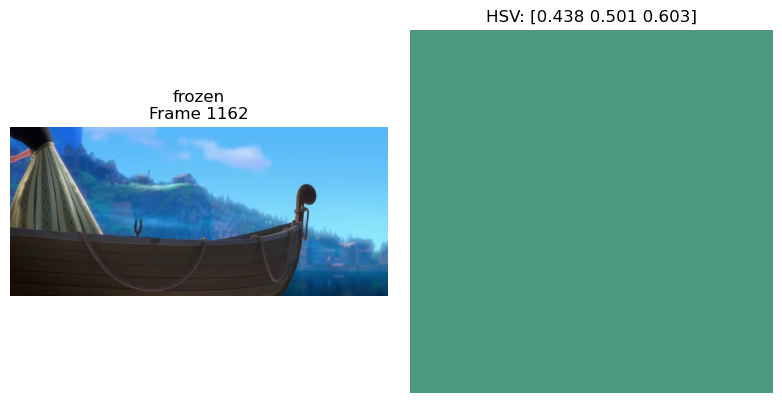

  moana — Frame 2009 — HSV: [0.36562229 0.48122759 0.56253574]


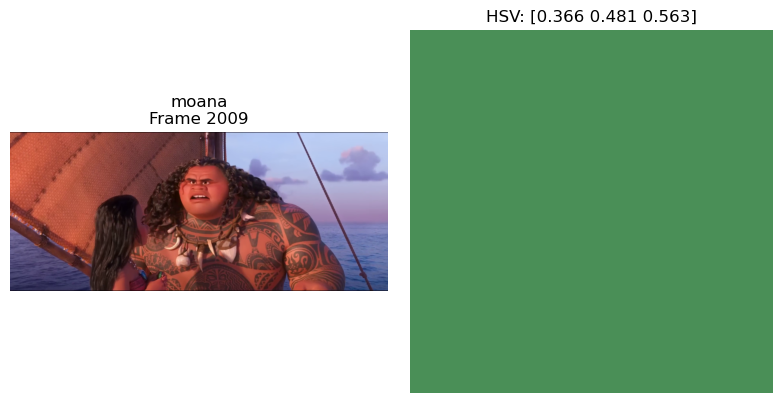


Cluster 6:
  frozen — Frame 635 — HSV: [0.08357151 0.84325973 0.11419696]


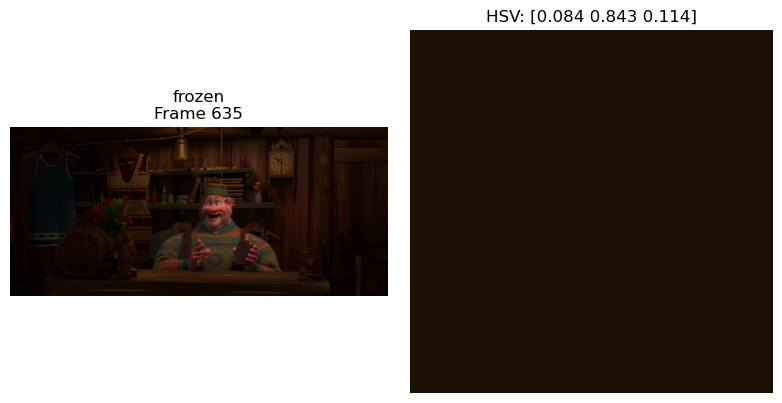

  moana — Frame 880 — HSV: [0.09733736 0.82471684 0.29164624]


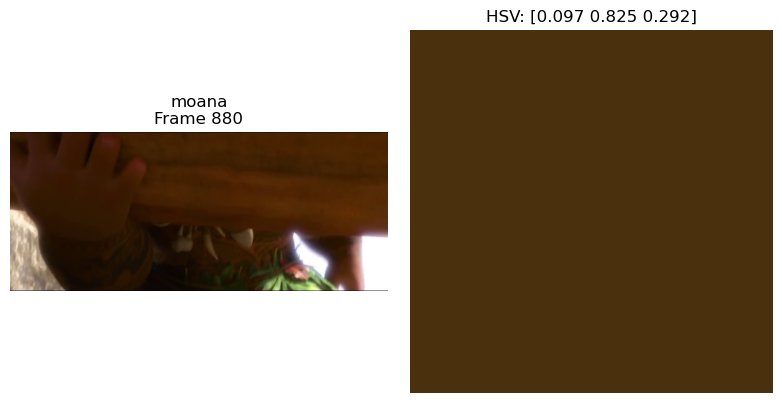


Cluster 7:
  frozen — Frame 333 — HSV: [0.45816532 0.32620877 0.33226614]


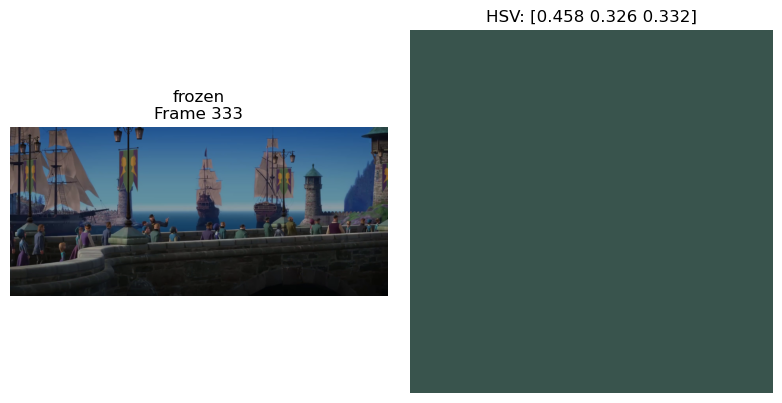

  moana — Frame 2452 — HSV: [0.50761007 0.38789251 0.31364549]


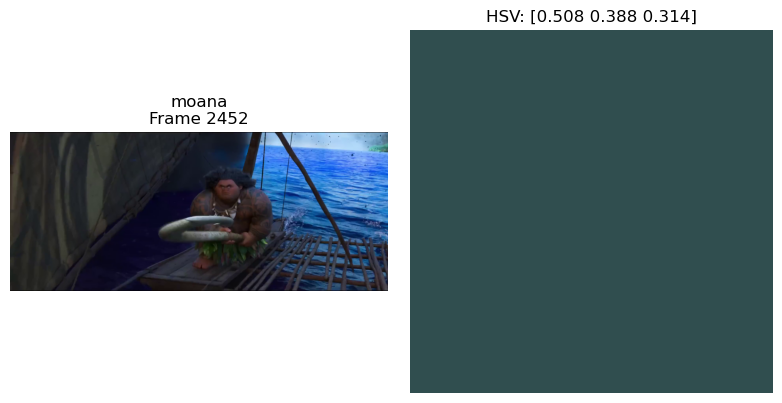


Cluster 8:
  frozen — Frame 1925 — HSV: [0.58885623 0.83931988 0.64500102]


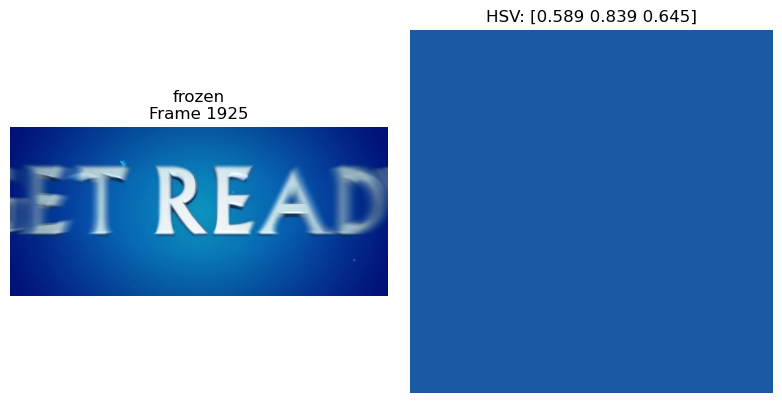

  moana — Frame 1144 — HSV: [0.60283808 0.87653124 0.67440768]


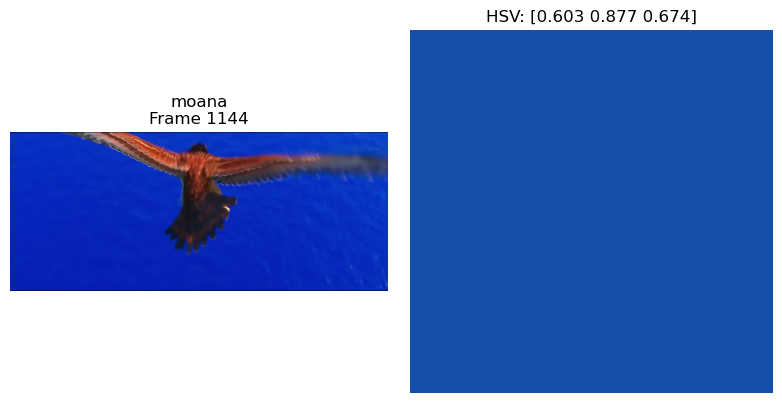


Cluster 9:
  frozen — Frame 896 — HSV: [0.03535397 0.00205848 0.99896855]


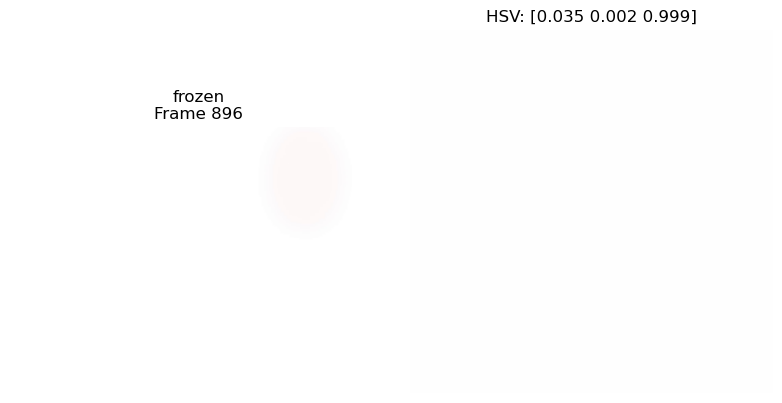

  moana — Frame 832 — HSV: [0.28828213 0.2132055  0.65715891]


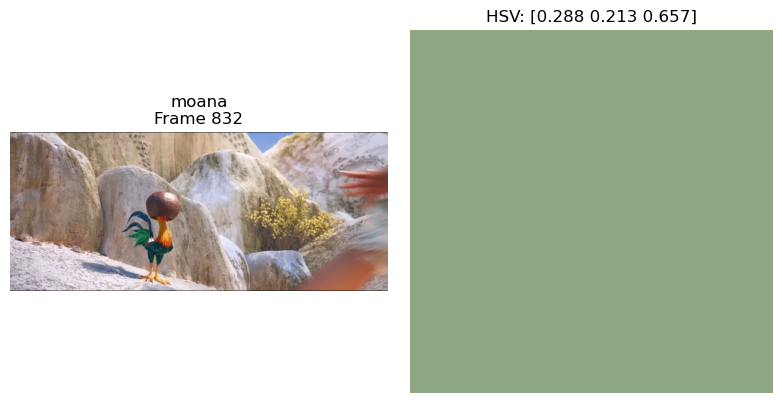


Cluster 10:
  frozen — Frame 691 — HSV: [0.65026772 0.59531509 0.39979405]


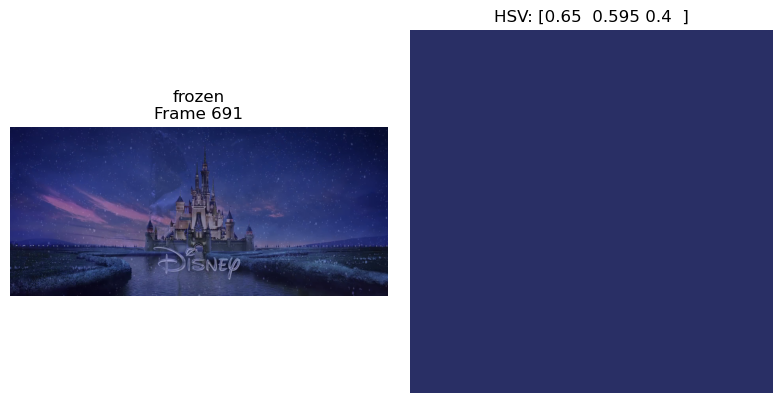

  moana — Frame 403 — HSV: [0.65998538 0.58405374 0.40912139]


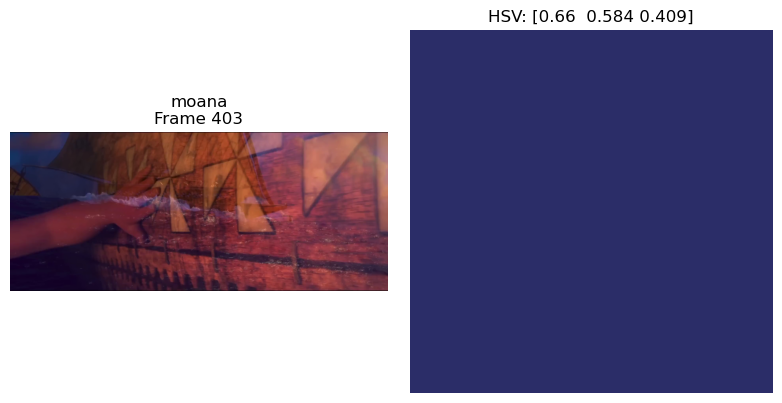


Cluster 11:
  frozen — Frame 3016 — HSV: [0.612328   0.45216453 0.80026893]


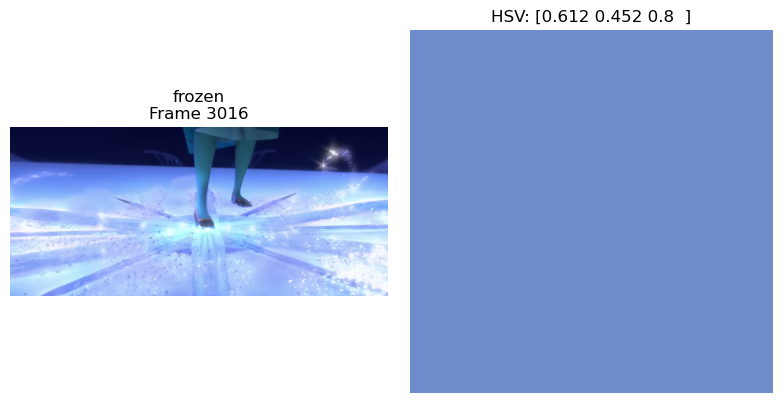

  moana — Frame 2212 — HSV: [0.57698228 0.42605938 0.77557019]


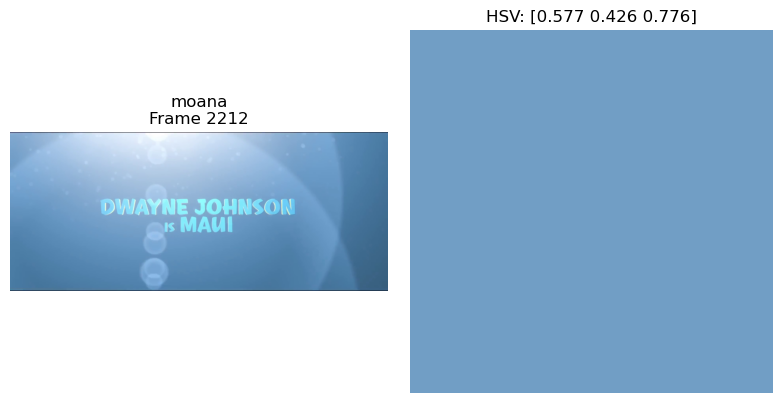

In [21]:
compare_two_movies_clusters("frozen", "moana", n_clusters=12)

In [22]:
def compare_movie_clusters(trailer_names, n_clusters=4, resize_dim=(64, 36), frame_skip=1):
    # Extract HSV data from all movies
    all_hsv = []
    all_indices = []
    all_names = []

    for trailer in trailer_names:
        hsv_vals, frame_ids, names = extract_avg_hsv_with_metadata(trailer, resize_dim, frame_skip)
        all_hsv.append(hsv_vals)
        all_indices.extend(frame_ids)
        all_names.extend(names)

    X = np.vstack(all_hsv)
    frame_meta = list(zip(all_names, all_indices))

    # Run KMeans
    kmeans = KMeans(n_clusters=n_clusters, random_state=0)
    cluster_labels = kmeans.fit_predict(X)

    # Silhouette Score
    sil = silhouette_score(X, cluster_labels)
    print(f"Silhouette Score: {sil:.3f}")

    # For each cluster, show best-matching frame from each movie
    for k in range(n_clusters):
        print(f"\nCluster {k}:")

        cluster_indices = np.where(cluster_labels == k)[0]
        center = kmeans.cluster_centers_[k]

        for trailer in trailer_names:
            movie_indices = [i for i in cluster_indices if frame_meta[i][0] == trailer]
            if movie_indices:
                dists = cdist(X[movie_indices], center.reshape(1, -1))
                closest_idx = movie_indices[np.argmin(dists)]
                trailer_name, frame_index = frame_meta[closest_idx]
                hsv_val = X[closest_idx]
                print(f"  {trailer_name} — Frame {frame_index} — HSV: {np.round(hsv_val, 3)}")
                show_frame_with_hsv(trailer_name, frame_index, hsv_val, cluster=k)
            else:
                print(f"  {trailer}: No frames in this cluster.")


In [23]:
def show_frame_with_hsv(trailer_name, frame_index, hsv_val, cluster):
    cap = cv2.VideoCapture(f"{trailer_name}.mp4")
    cap.set(cv2.CAP_PROP_POS_FRAMES, frame_index)
    ret, frame = cap.read()
    cap.release()
    
    if ret:
        rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
        color_rgb = hsv_to_rgb(np.array(hsv_val).reshape(1, 1, 3)).squeeze()

        fig, axs = plt.subplots(1, 2, figsize=(8, 4))
        axs[0].imshow(rgb)
        axs[0].axis('off')
        axs[0].set_title(f"{trailer_name}\nFrame {frame_index}")

        axs[1].imshow(np.ones((100, 100, 3)) * color_rgb)
        axs[1].axis('off')
        axs[1].set_title(f"HSV: {np.round(hsv_val, 3)}")

        plt.tight_layout()
        plt.show()
    else:
        print(f"Could not retrieve frame {frame_index} from {trailer_name}.")


Silhouette Score: 0.356

Cluster 0:
  elemental — Frame 2182 — HSV: [0.579 0.8   0.396]


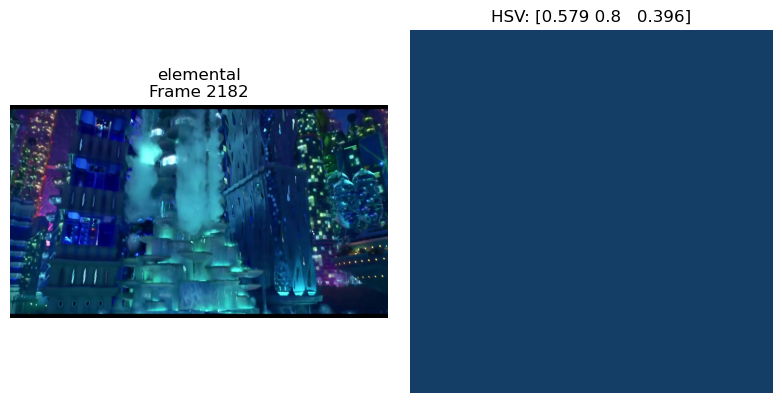

  moana — Frame 10 — HSV: [0.579 0.76  0.407]


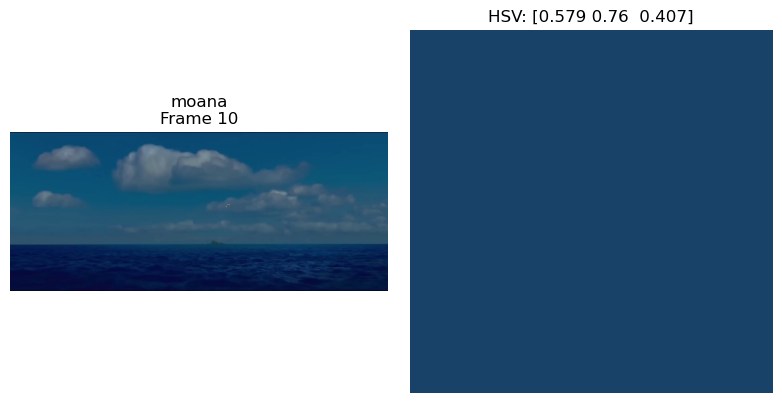


Cluster 1:
  elemental — Frame 1564 — HSV: [0.31  0.394 0.619]


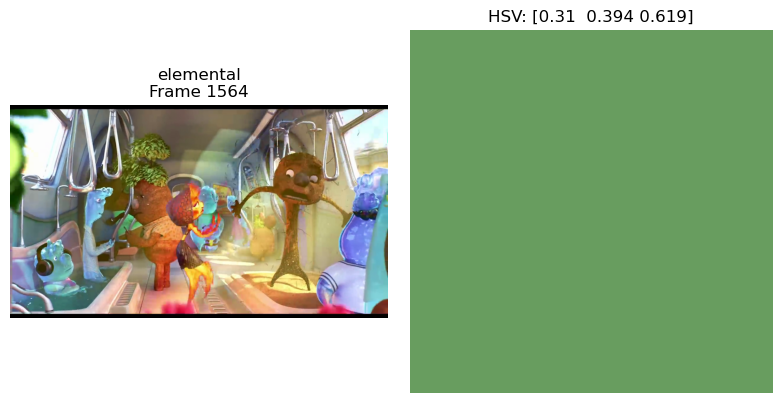

  moana — Frame 1441 — HSV: [0.313 0.404 0.581]


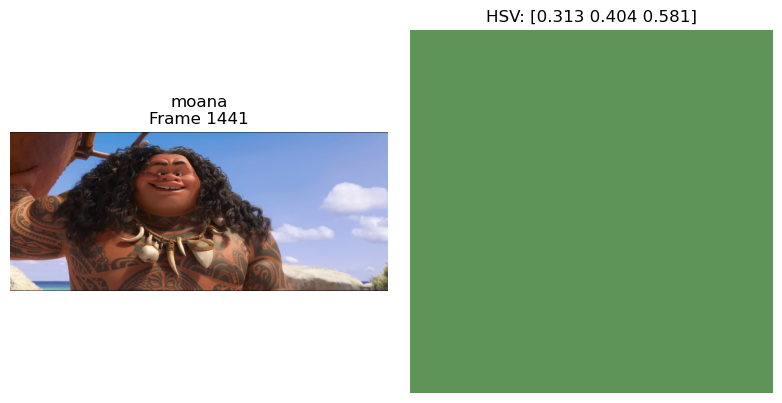


Cluster 2:
  elemental — Frame 2010 — HSV: [0.025 0.038 0.028]


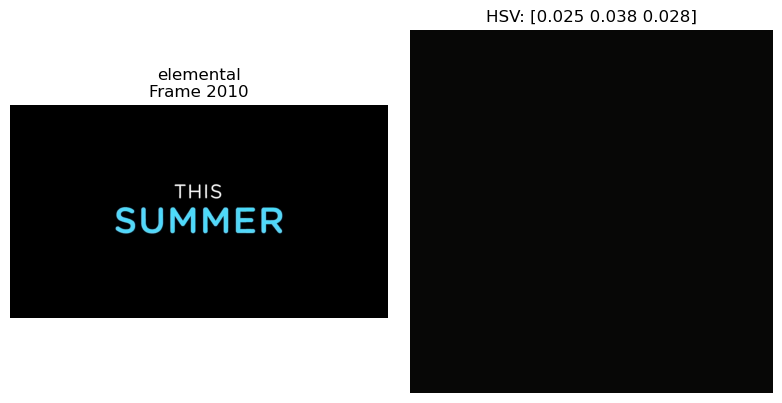

  moana — Frame 3411 — HSV: [0.043 0.069 0.03 ]


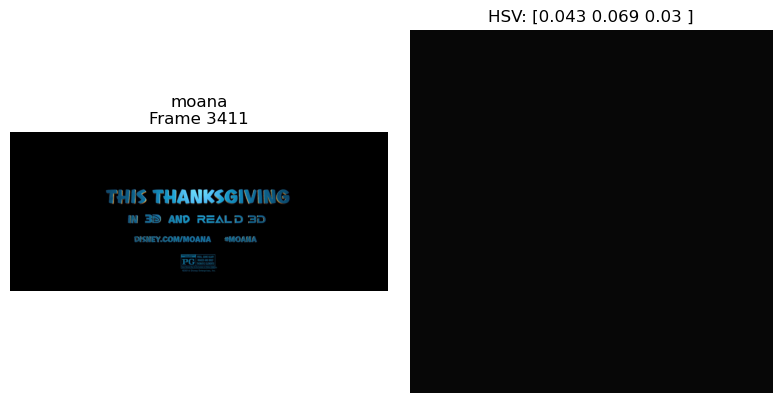


Cluster 3:
  elemental — Frame 861 — HSV: [0.212 0.731 0.625]


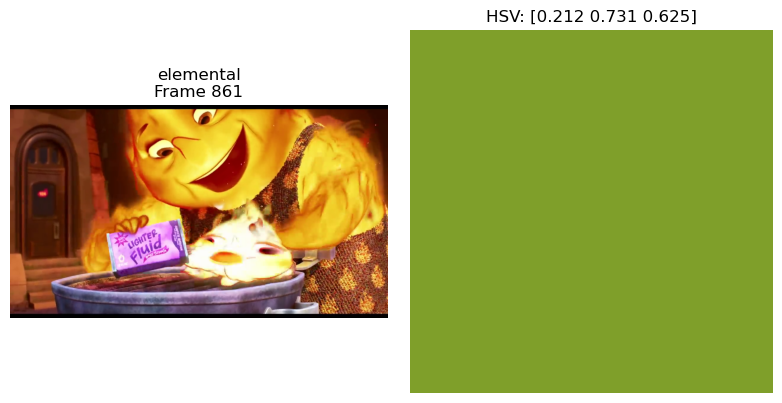

  moana — Frame 883 — HSV: [0.136 0.593 0.483]


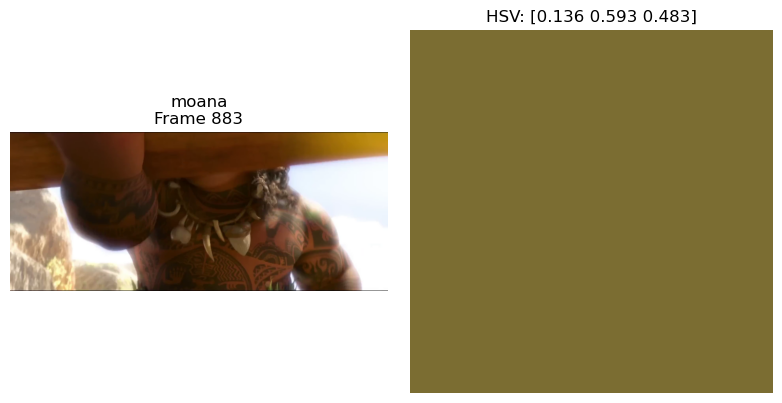


Cluster 4:
  elemental — Frame 2096 — HSV: [0.614 0.44  0.726]


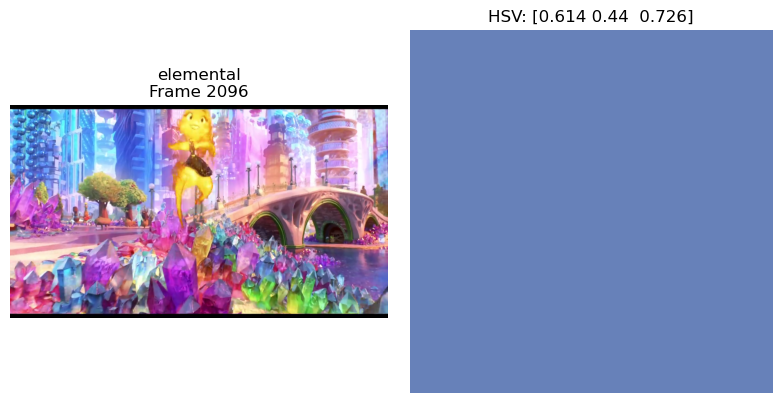

  moana — Frame 2699 — HSV: [0.604 0.429 0.724]


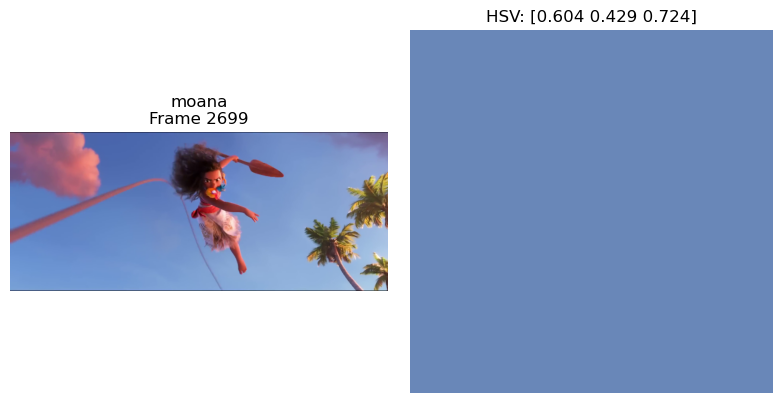


Cluster 5:
  elemental — Frame 383 — HSV: [0.159 0.716 0.229]


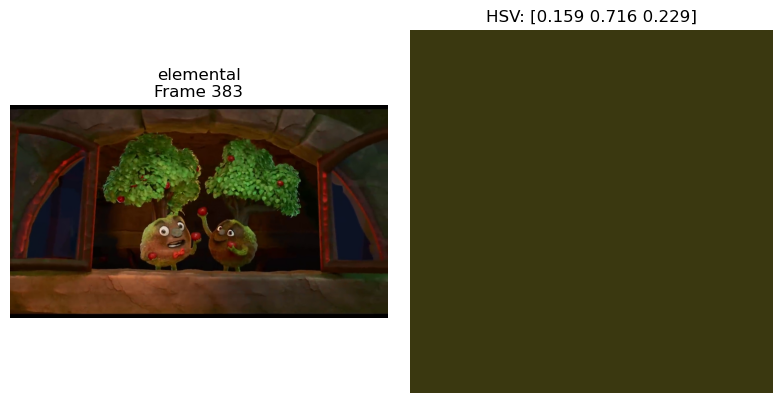

  moana — Frame 177 — HSV: [0.182 0.637 0.226]


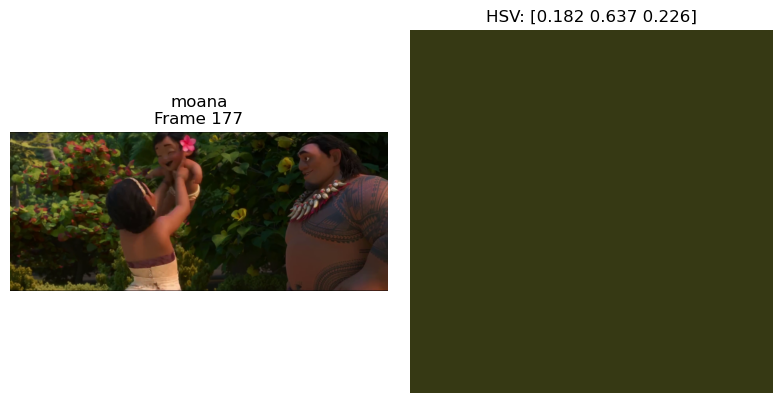


Cluster 6:
  elemental — Frame 1767 — HSV: [0.413 0.505 0.223]


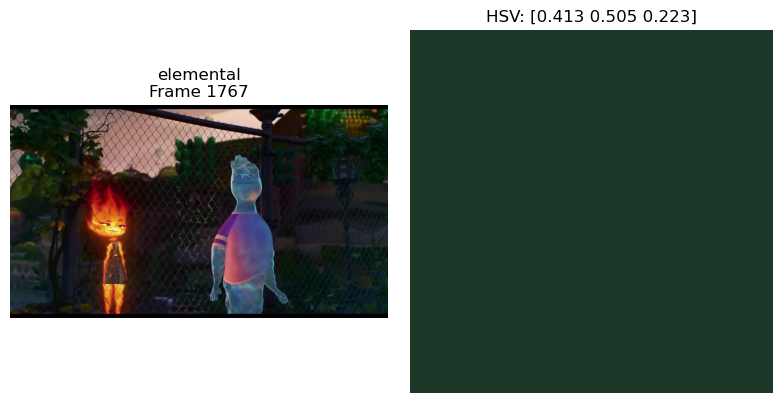

  moana — Frame 2493 — HSV: [0.457 0.499 0.207]


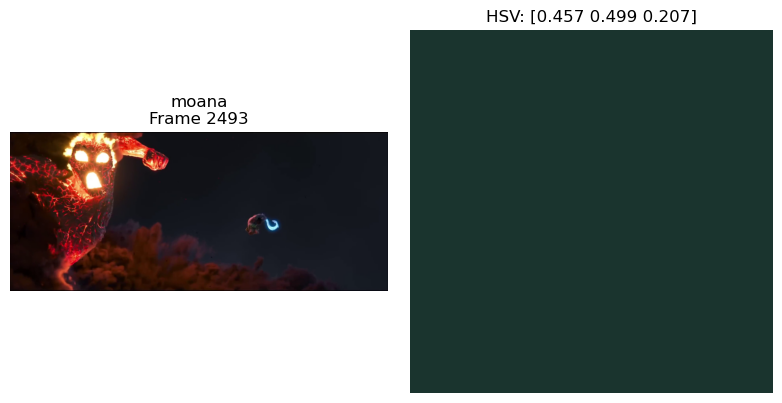


Cluster 7:
  elemental — Frame 1358 — HSV: [0.586 0.467 0.439]


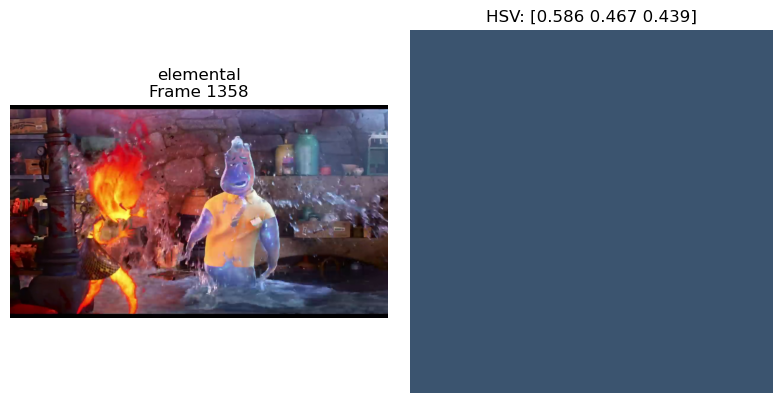

  moana — Frame 1965 — HSV: [0.601 0.503 0.444]


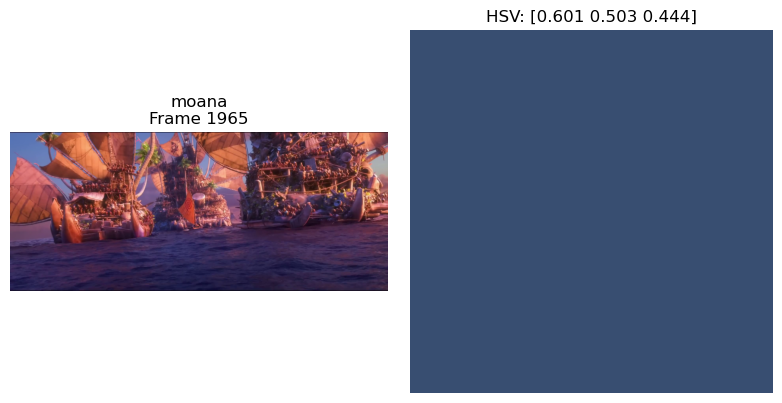

In [24]:
compare_movie_clusters(["elemental", "moana"], n_clusters=8)

Silhouette Score: 0.360

Cluster 0:
  inside out — Frame 2931 — HSV: [0.12  0.607 0.287]


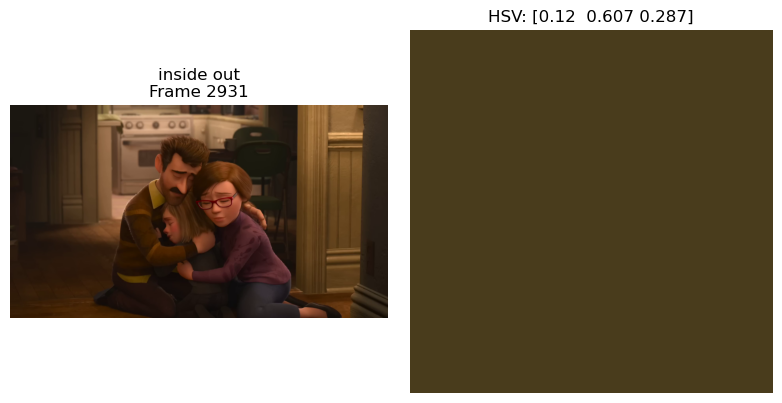

  madmax — Frame 3469 — HSV: [0.107 0.68  0.209]


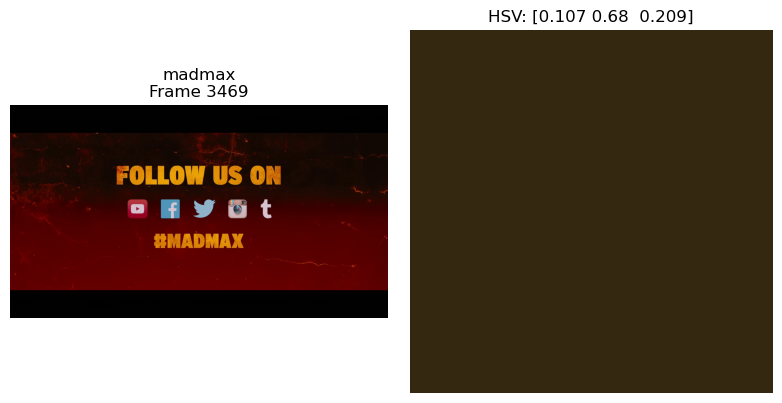

  elemental — Frame 386 — HSV: [0.156 0.713 0.232]


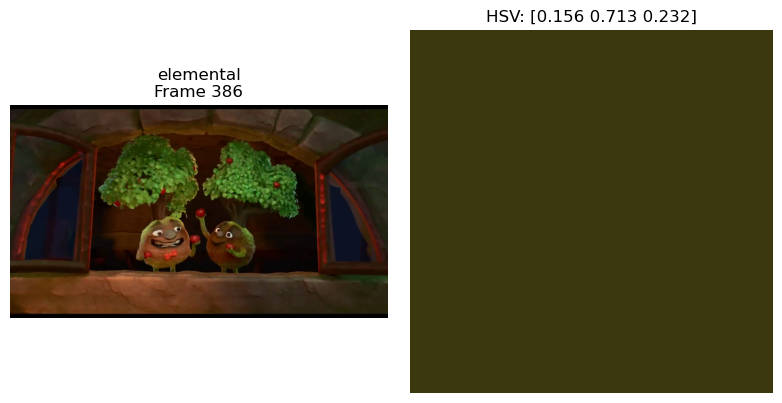

  avatar — Frame 1286 — HSV: [0.105 0.65  0.023]


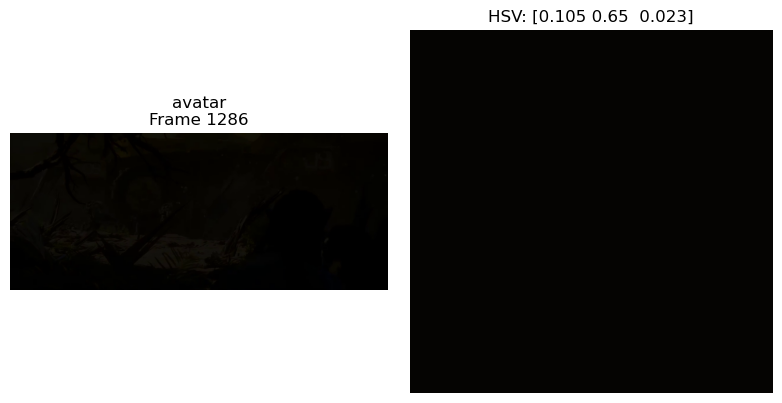

  frozen — Frame 1041 — HSV: [0.141 0.653 0.231]


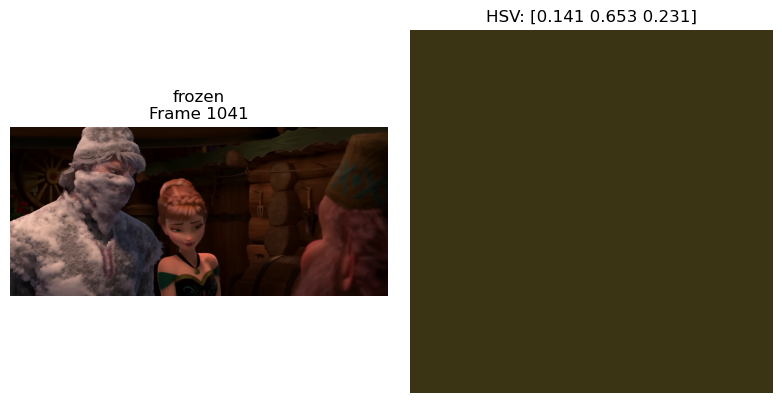

  shawshank — Frame 303 — HSV: [0.267 0.595 0.151]


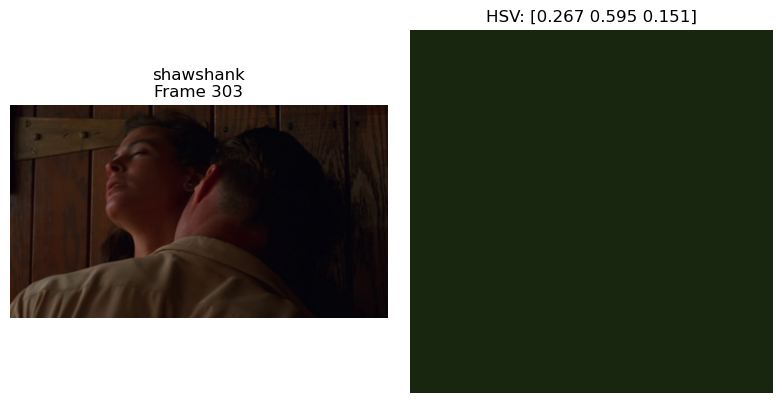

  soul — Frame 585 — HSV: [0.074 0.726 0.173]


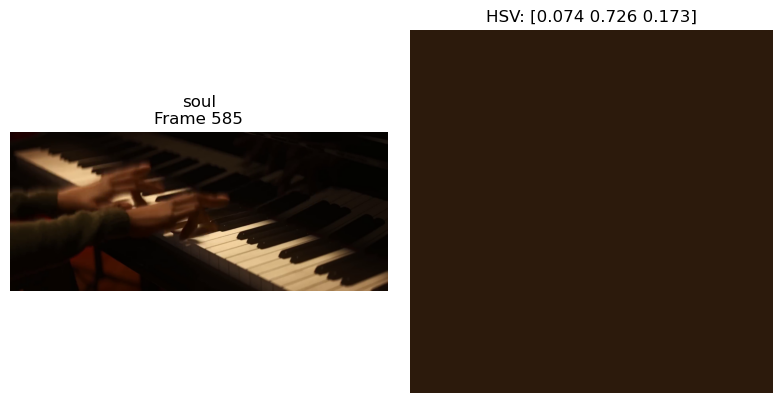

  lalaland — Frame 1185 — HSV: [0.173 0.598 0.162]


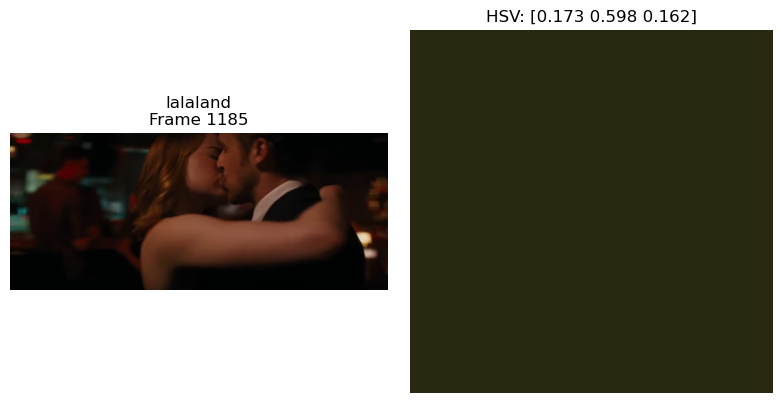


Cluster 1:
  inside out — Frame 2362 — HSV: [0.525 0.218 0.28 ]


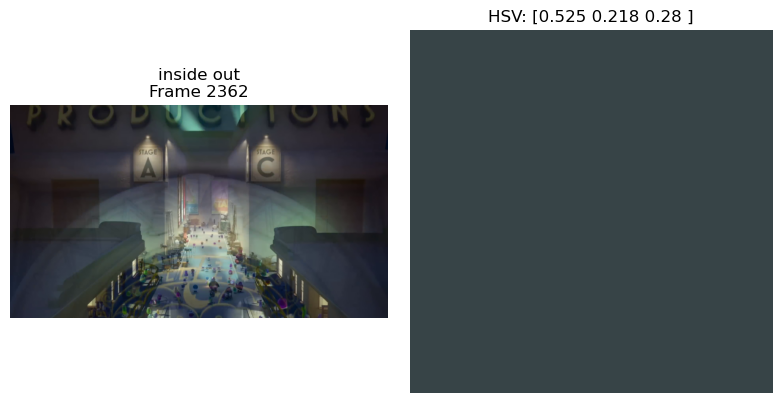

  madmax — Frame 1707 — HSV: [0.549 0.208 0.302]


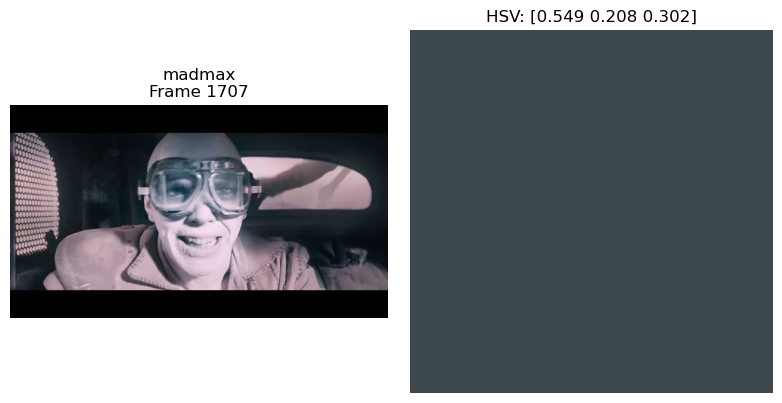

  elemental — Frame 8 — HSV: [0.61  0.37  0.239]


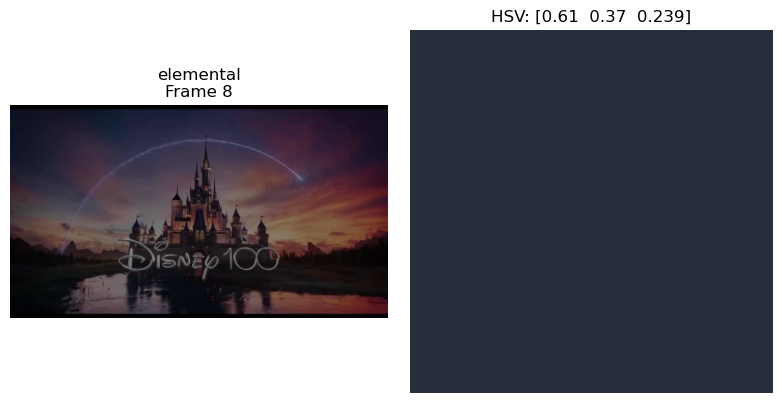

  avatar — Frame 4274 — HSV: [0.477 0.271 0.251]


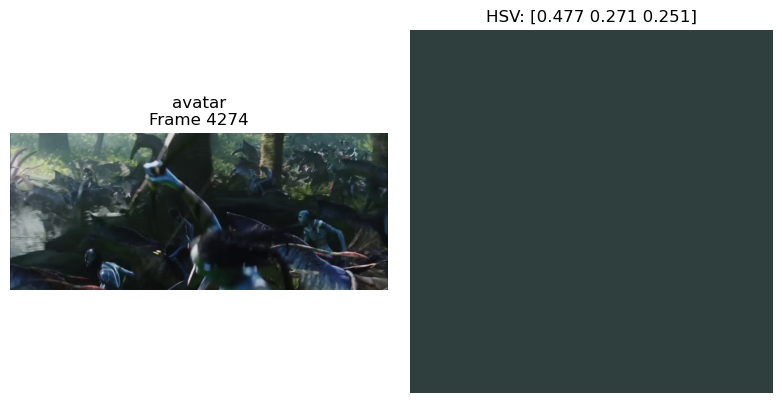

  frozen — Frame 334 — HSV: [0.466 0.317 0.285]


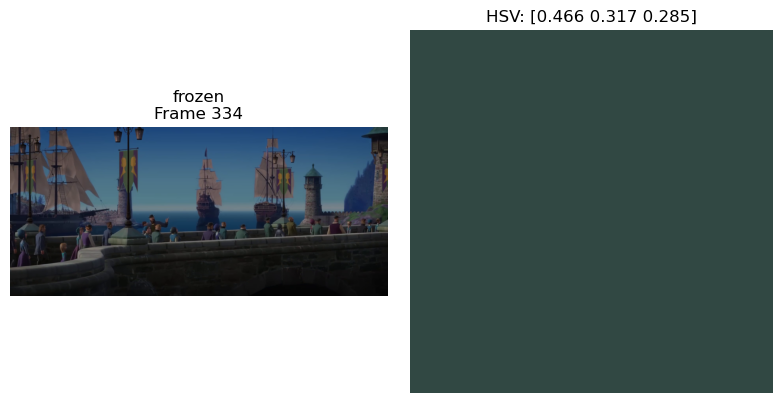

  shawshank — Frame 600 — HSV: [0.483 0.28  0.244]


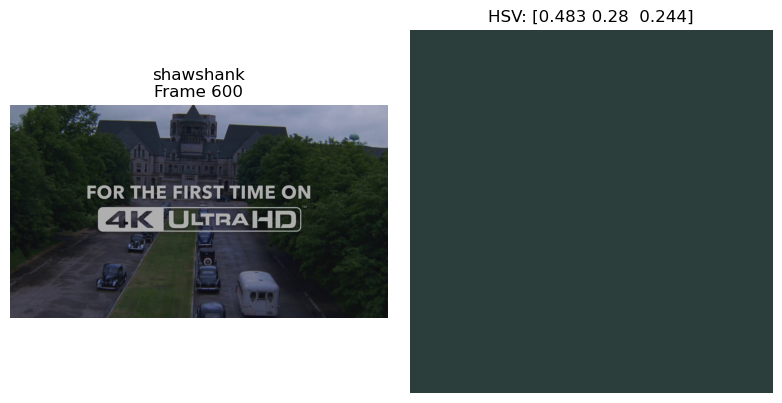

  soul — Frame 2623 — HSV: [0.488 0.311 0.177]


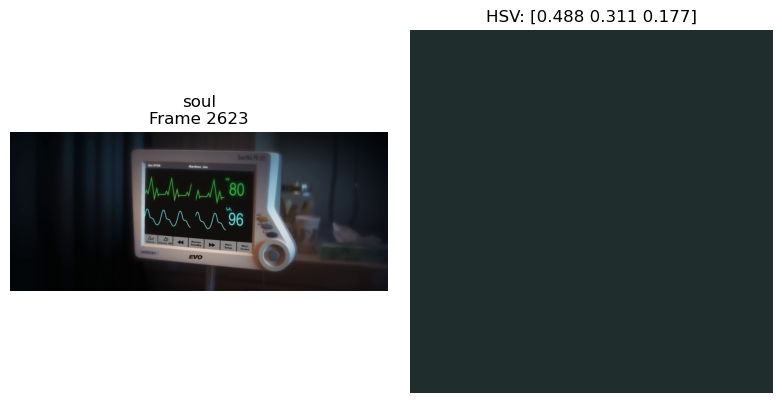

  lalaland — Frame 2822 — HSV: [0.502 0.245 0.225]


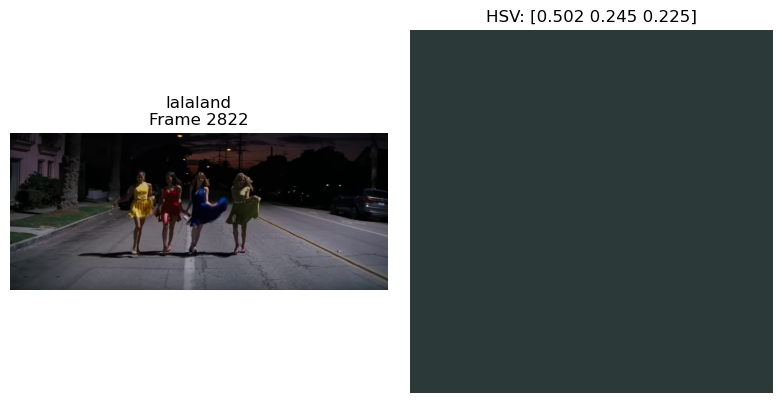


Cluster 2:
  inside out — Frame 3314 — HSV: [0.159 0.361 0.144]


[h264 @ 0x58ec7fc766c0] mmco: unref short failure


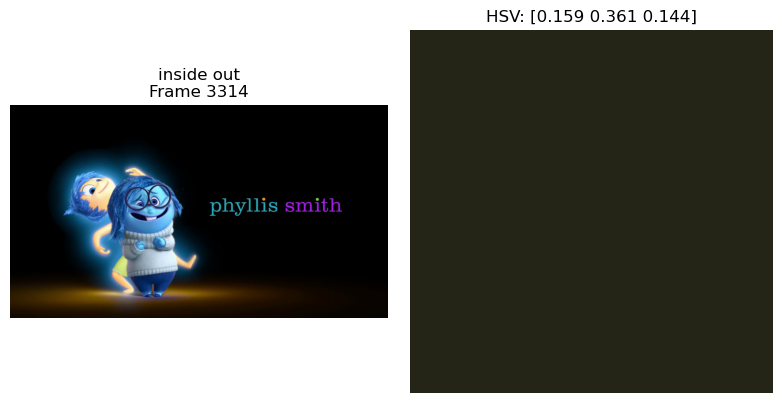

  madmax — Frame 159 — HSV: [0.153 0.392 0.131]


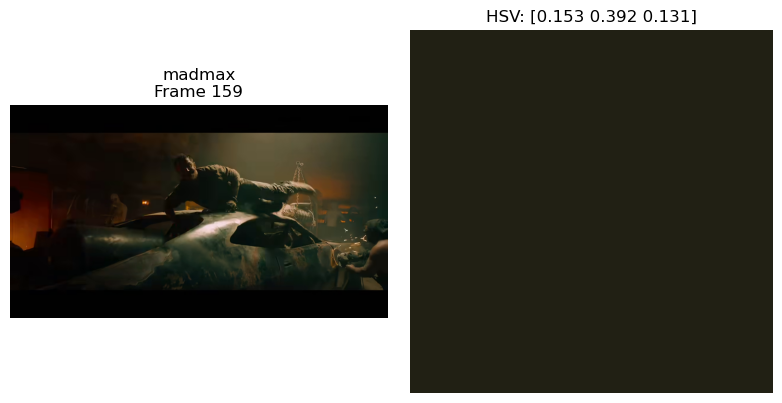

  elemental — Frame 1698 — HSV: [0.26  0.433 0.12 ]


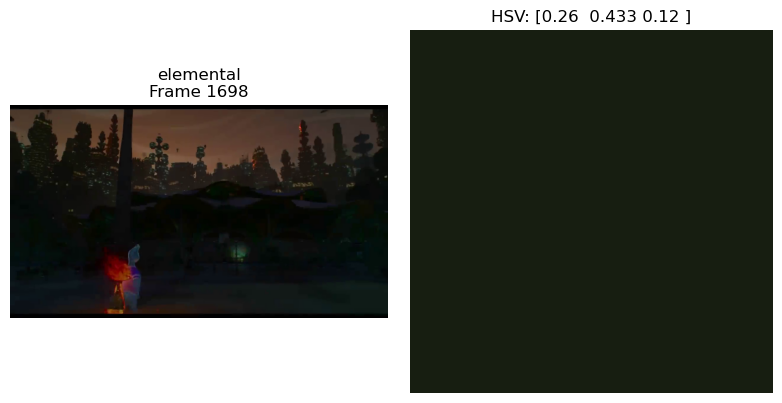

  avatar — Frame 3064 — HSV: [0.167 0.416 0.155]


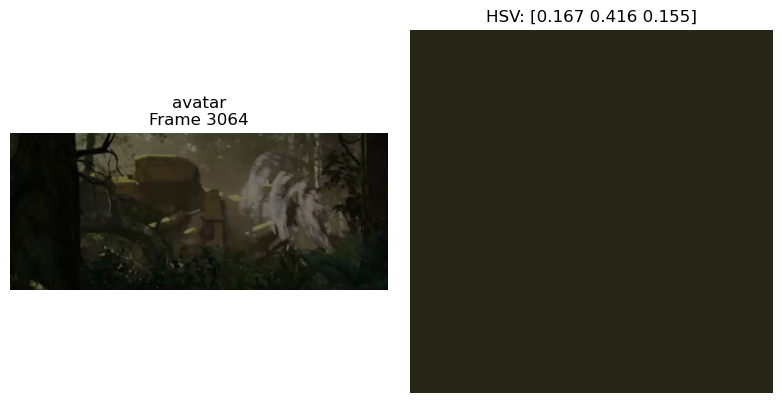

  frozen — Frame 3193 — HSV: [0.261 0.423 0.259]


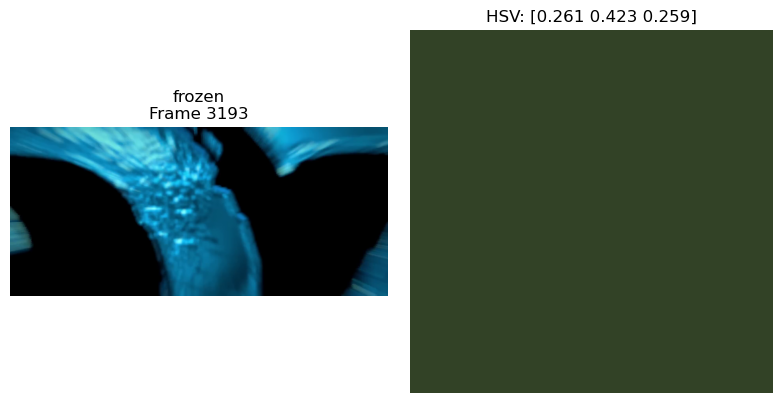

  shawshank — Frame 2374 — HSV: [0.19  0.333 0.137]


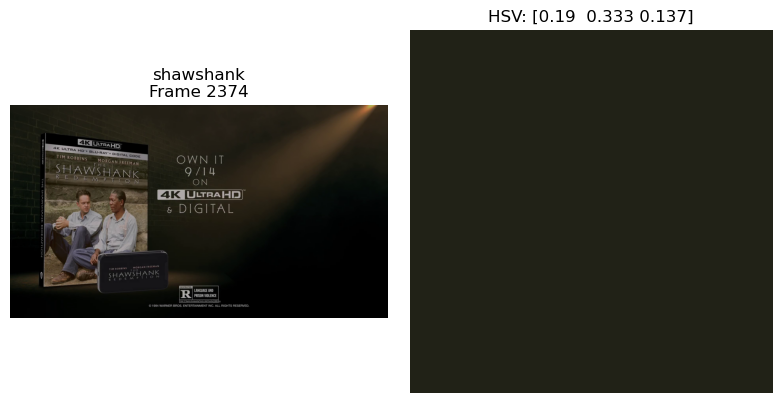

  soul — Frame 2629 — HSV: [0.18  0.463 0.126]


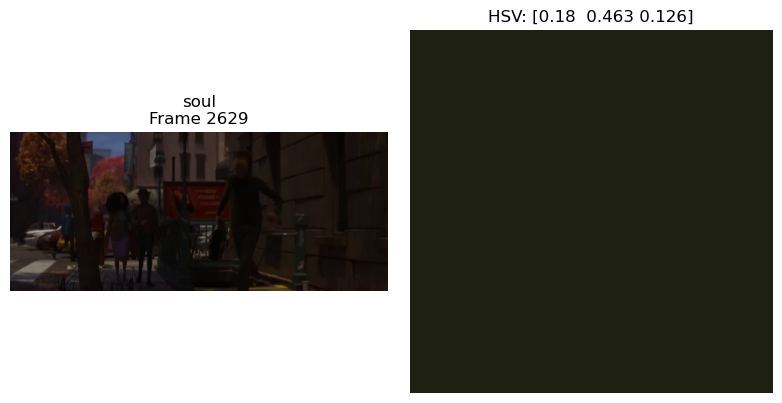

  lalaland — Frame 1937 — HSV: [0.241 0.396 0.122]


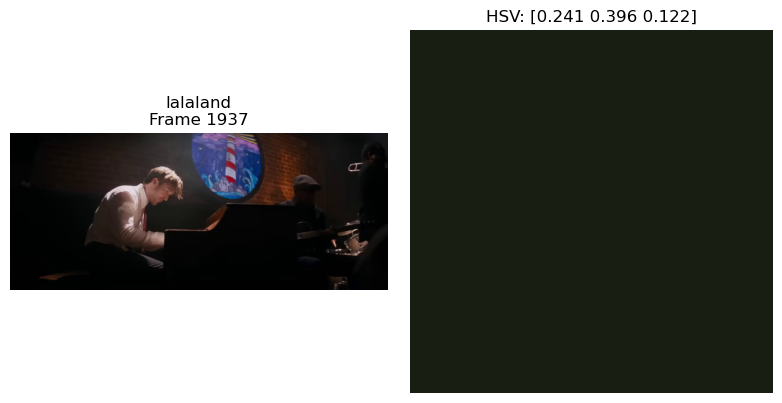


Cluster 3:
  inside out — Frame 348 — HSV: [0.316 0.644 0.499]


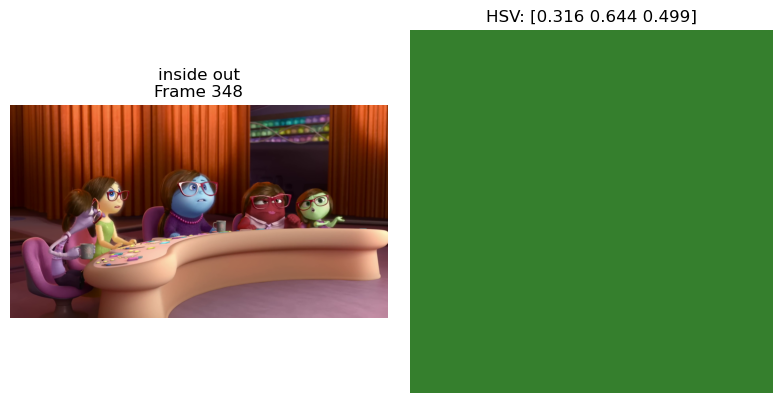

  madmax — Frame 2426 — HSV: [0.223 0.753 0.465]


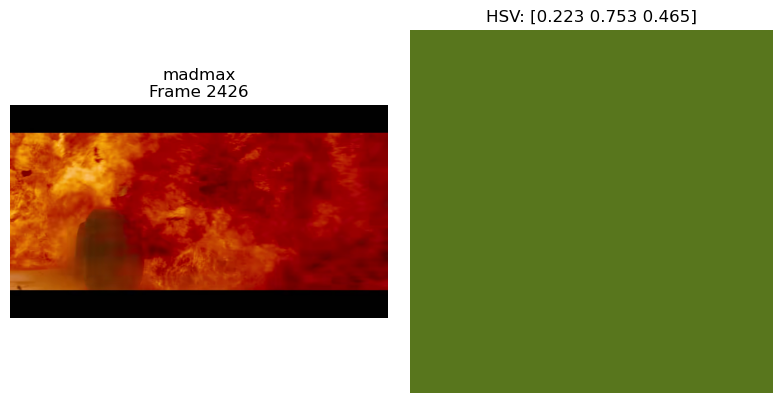

  elemental — Frame 792 — HSV: [0.267 0.725 0.542]


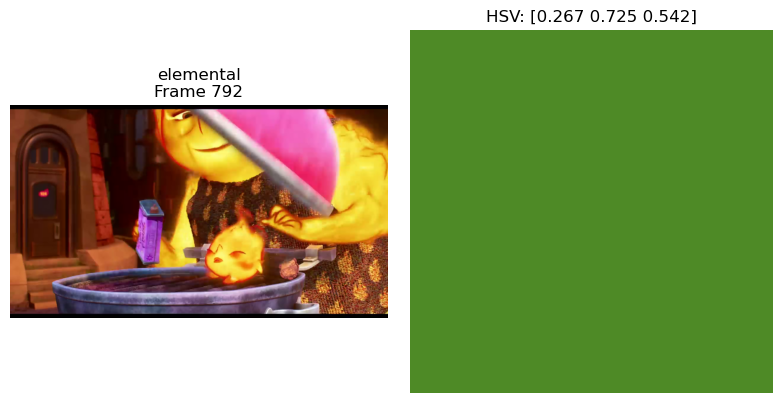

  avatar — Frame 1 — HSV: [0.326 0.933 0.595]


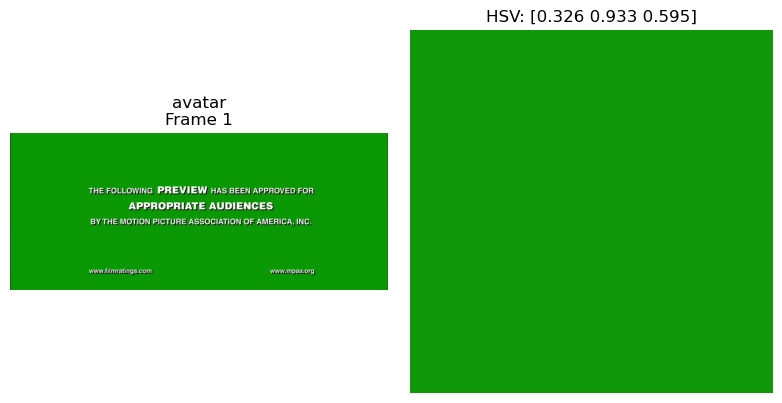

  frozen — Frame 34 — HSV: [0.309 0.939 0.402]


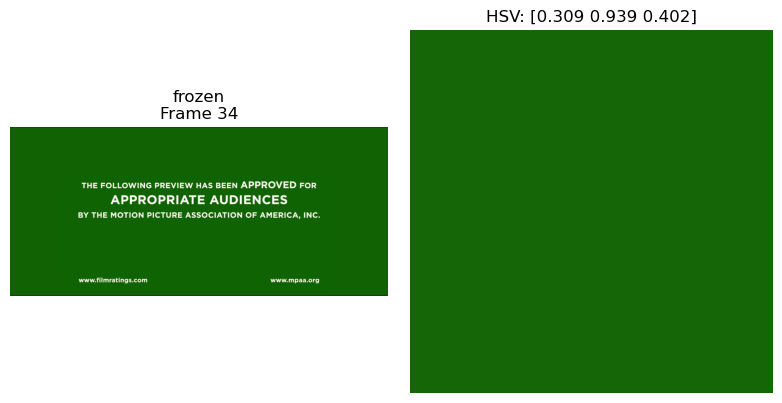

  shawshank — Frame 0 — HSV: [0.325 0.723 0.37 ]


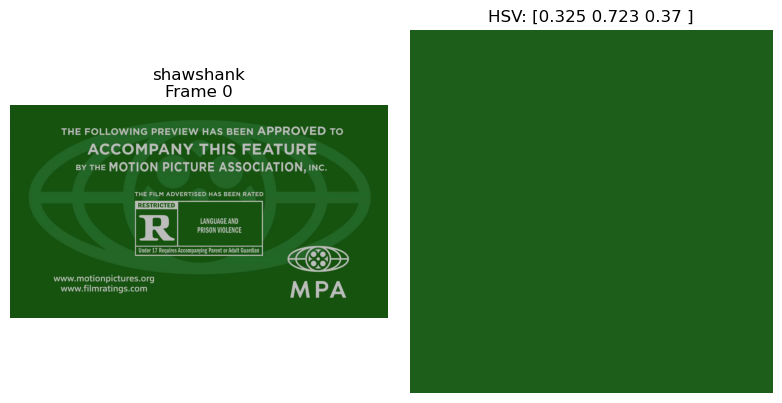

  soul — Frame 651 — HSV: [0.185 0.629 0.412]


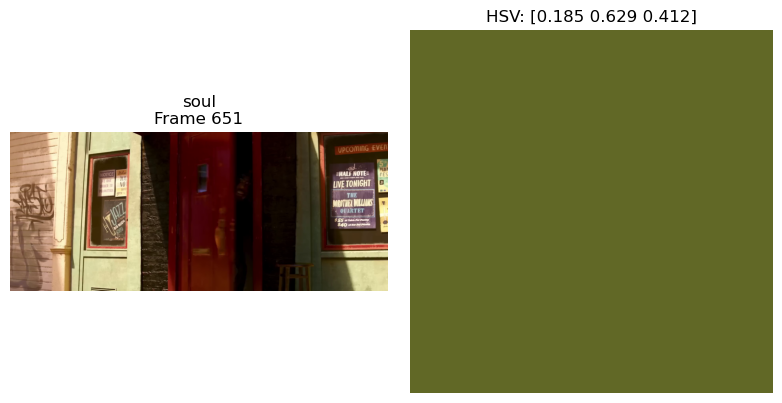

  lalaland — Frame 2658 — HSV: [0.366 0.684 0.564]


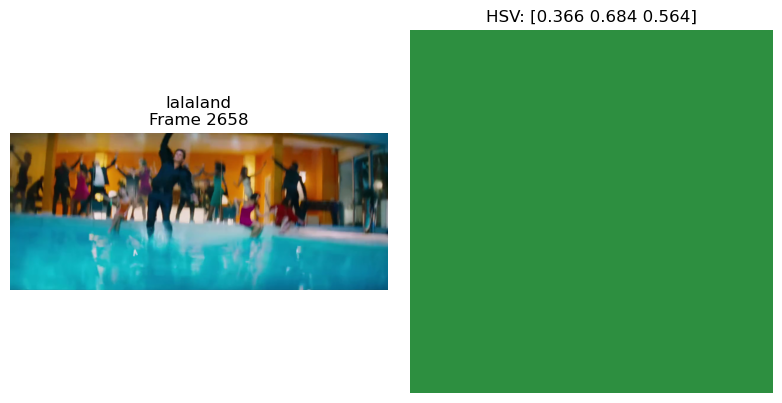


Cluster 4:
  inside out — Frame 2542 — HSV: [0.04  0.042 0.049]


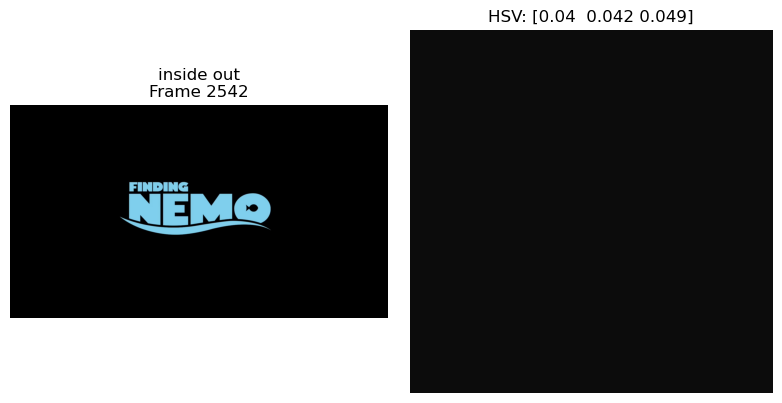

  madmax — Frame 808 — HSV: [0.07  0.058 0.007]


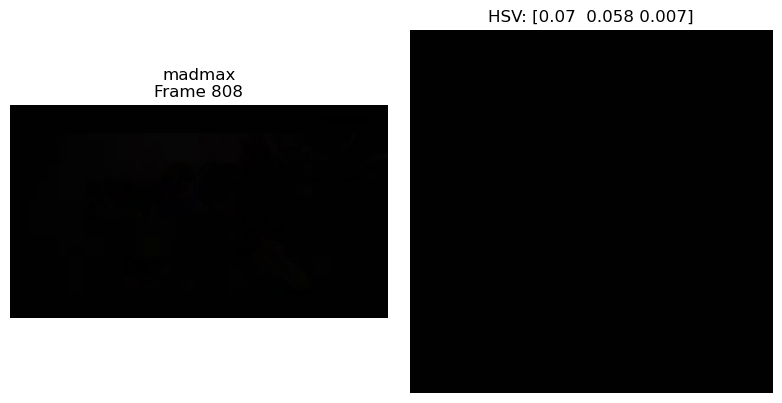

  elemental — Frame 2010 — HSV: [0.025 0.038 0.028]


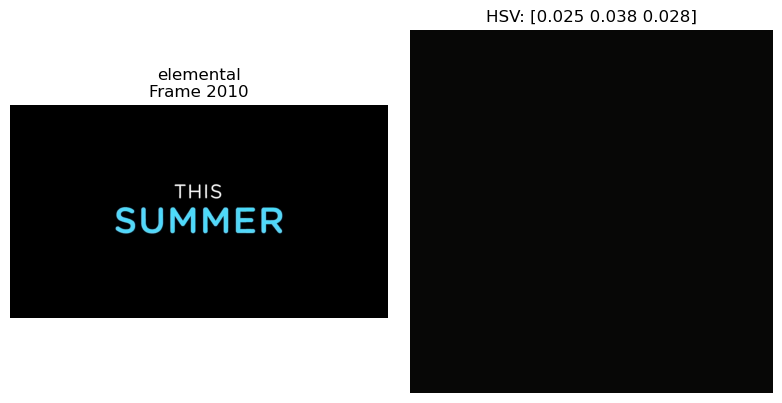

  avatar — Frame 4341 — HSV: [0.061 0.05  0.052]


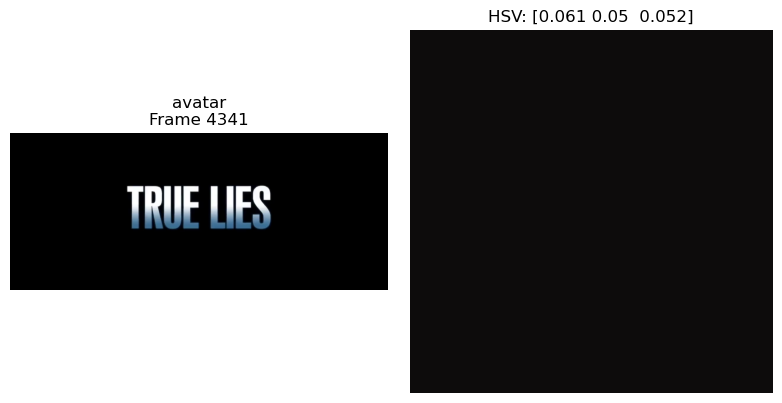

  frozen — Frame 3555 — HSV: [0.056 0.057 0.05 ]


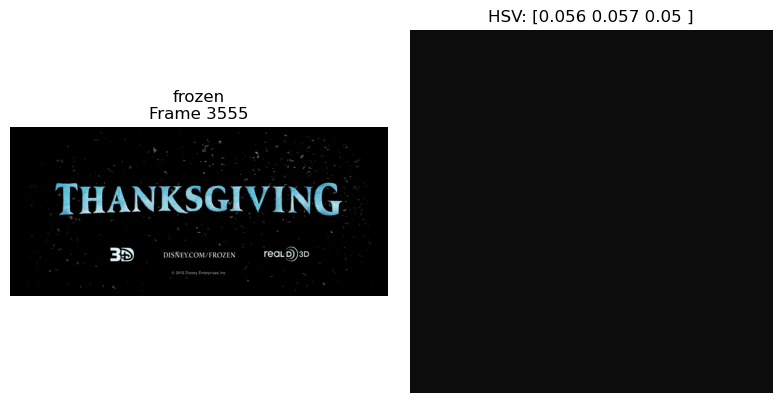

  shawshank — Frame 990 — HSV: [0.049 0.022 0.027]


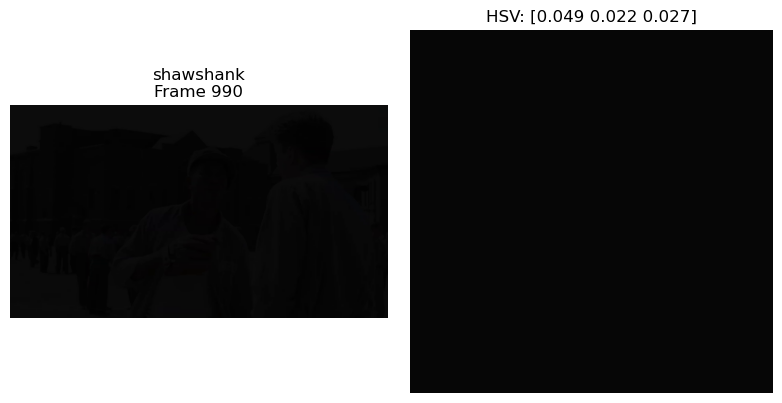

  soul — Frame 190 — HSV: [0.052 0.052 0.052]


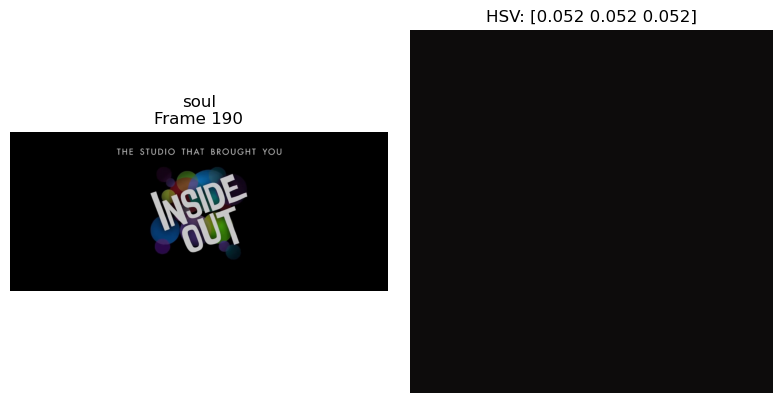

  lalaland — Frame 760 — HSV: [0.028 0.065 0.022]


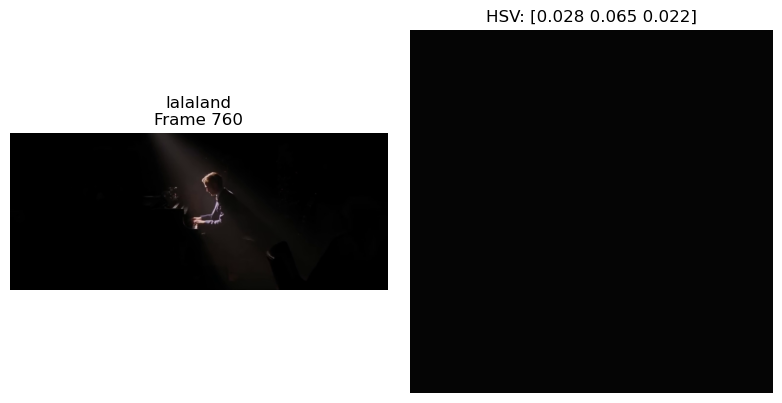


Cluster 5:
  inside out — Frame 3428 — HSV: [0.522 0.291 0.55 ]


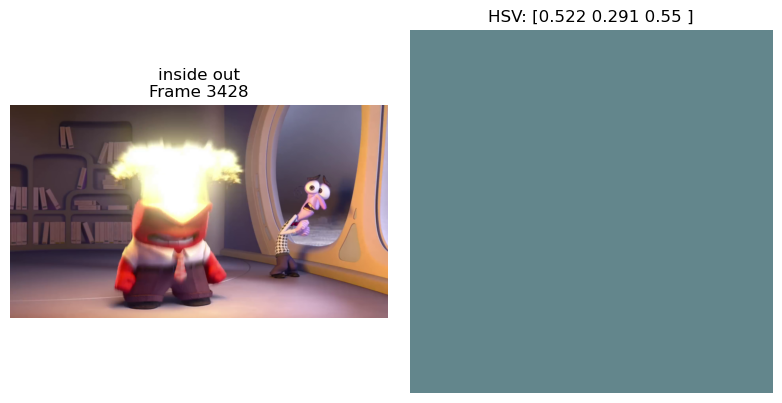

  madmax — Frame 1729 — HSV: [0.567 0.138 0.611]


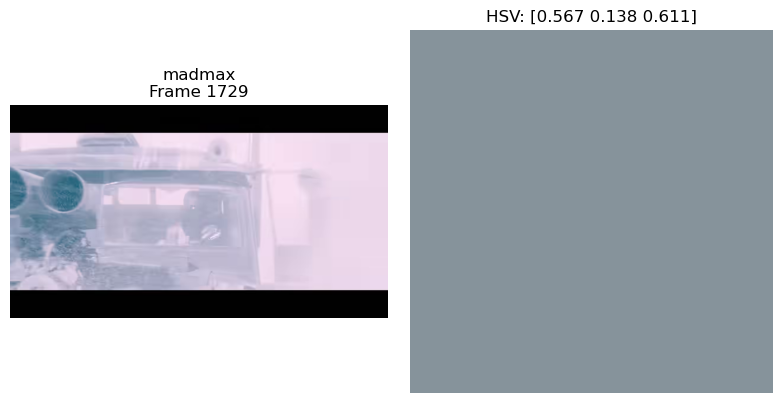

  elemental — Frame 545 — HSV: [0.55  0.339 0.558]


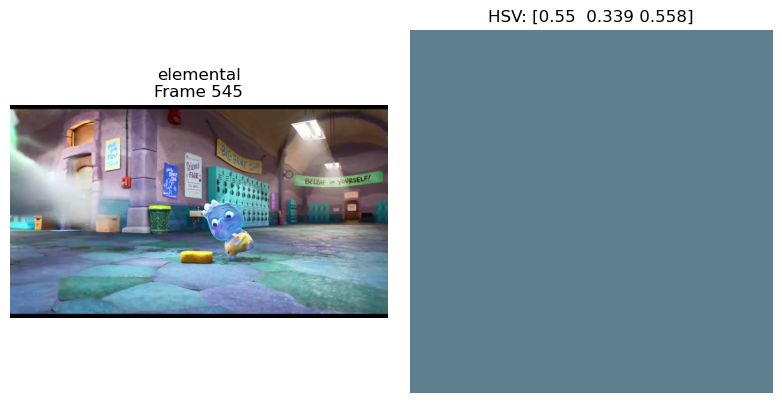

  avatar — Frame 4408 — HSV: [0.523 0.251 0.568]


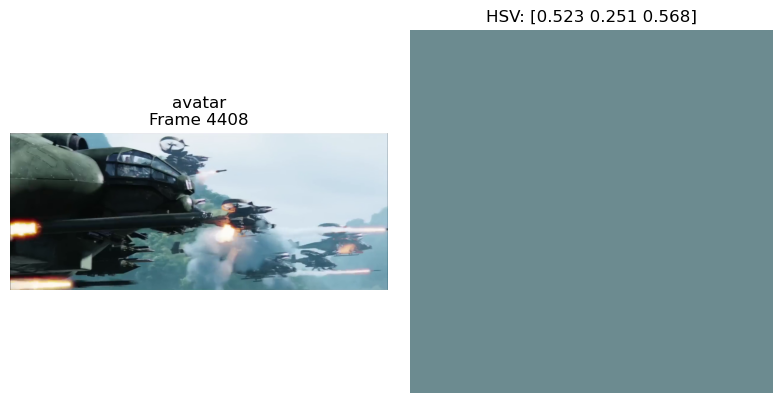

  frozen — Frame 1822 — HSV: [0.653 0.264 0.599]


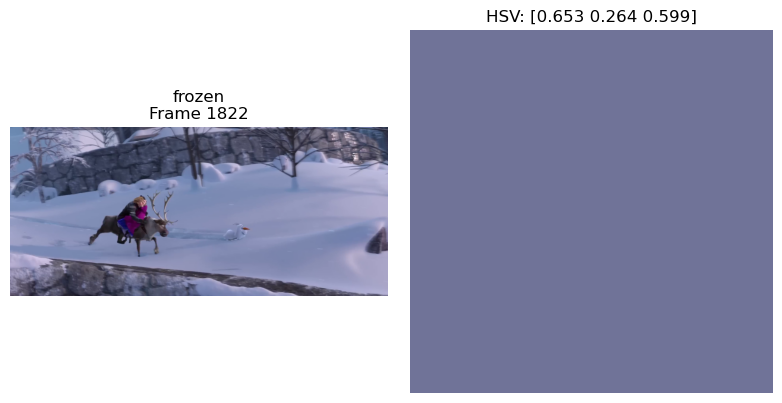

  shawshank — Frame 965 — HSV: [0.66  0.26  0.556]


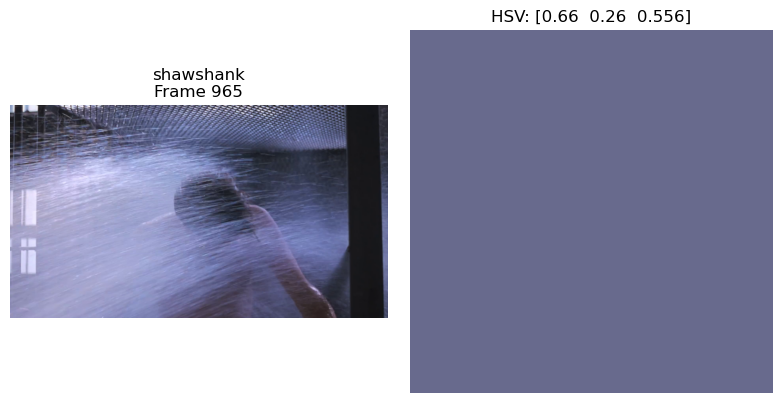

  soul — Frame 1920 — HSV: [0.615 0.212 0.57 ]


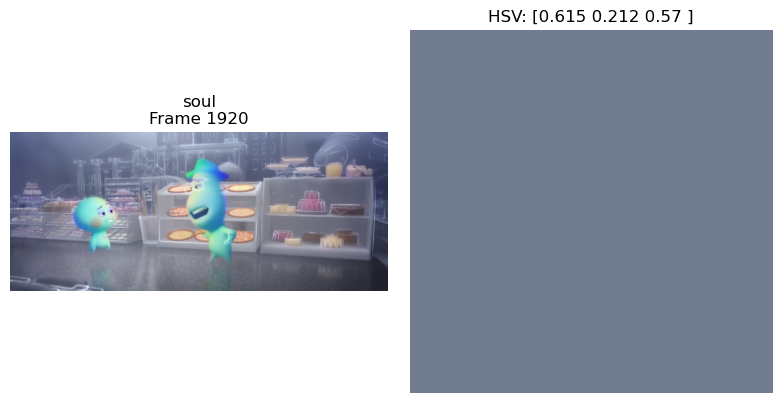

  lalaland — Frame 97 — HSV: [0.644 0.219 0.565]


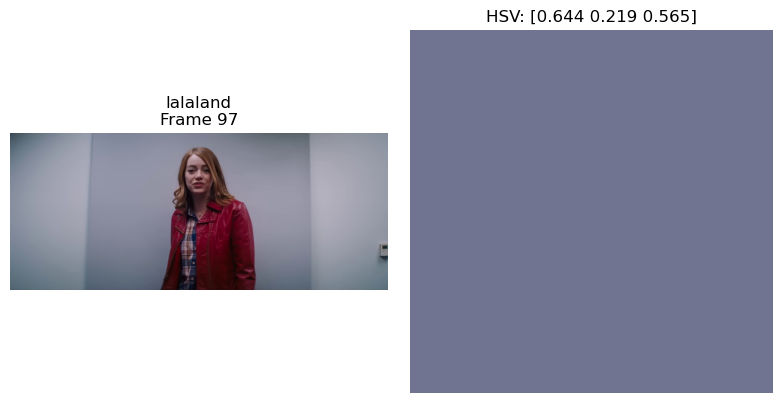


Cluster 6:
  inside out — Frame 26 — HSV: [0.634 0.806 0.153]


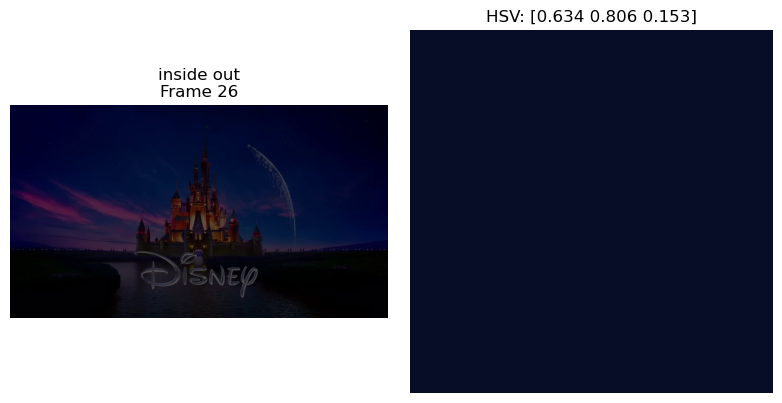

  madmax: No frames in this cluster.
  elemental — Frame 2548 — HSV: [0.771 0.891 0.248]


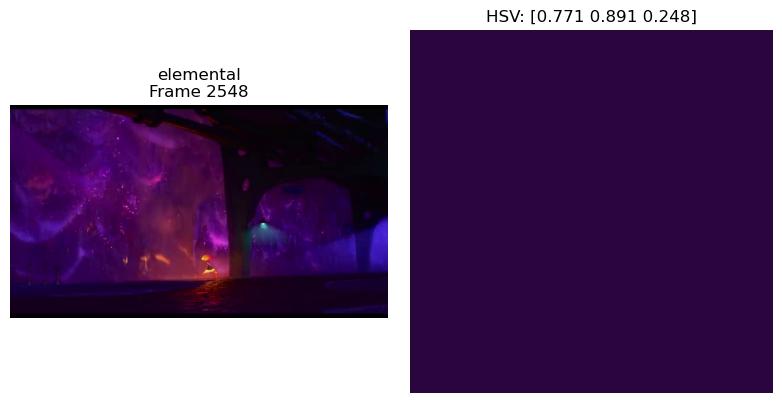

  avatar — Frame 1914 — HSV: [0.62  0.834 0.195]


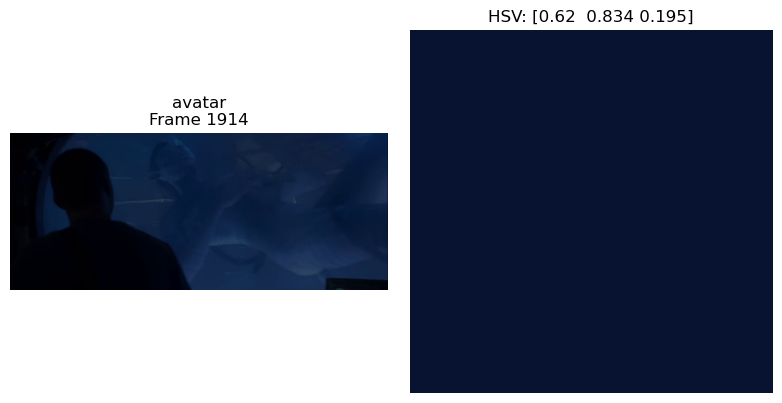

  frozen — Frame 3280 — HSV: [0.632 0.824 0.175]


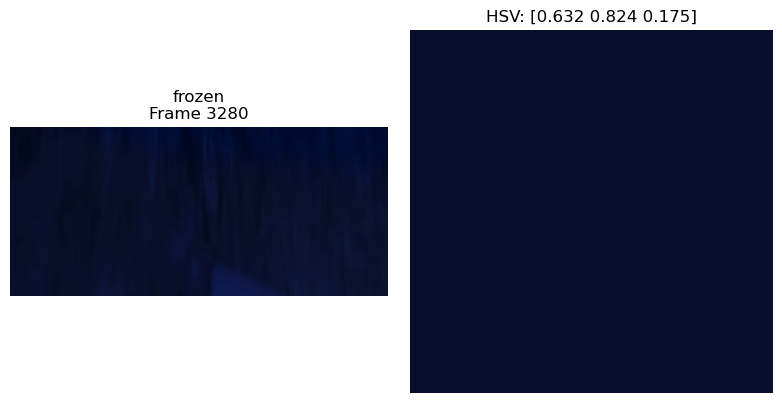

  shawshank — Frame 289 — HSV: [0.562 0.713 0.094]


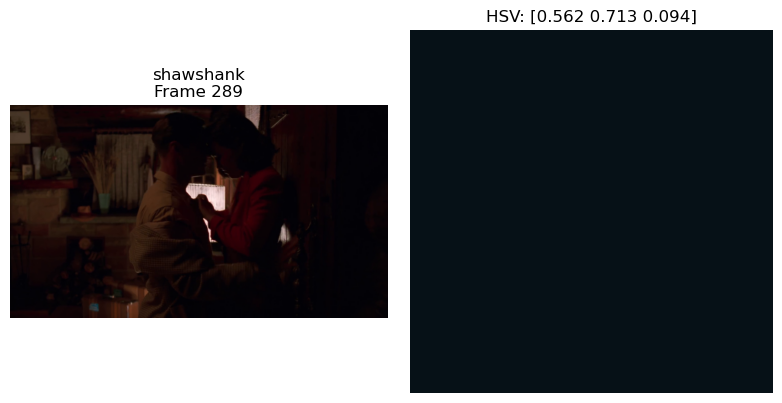

  soul — Frame 2569 — HSV: [0.608 0.881 0.14 ]


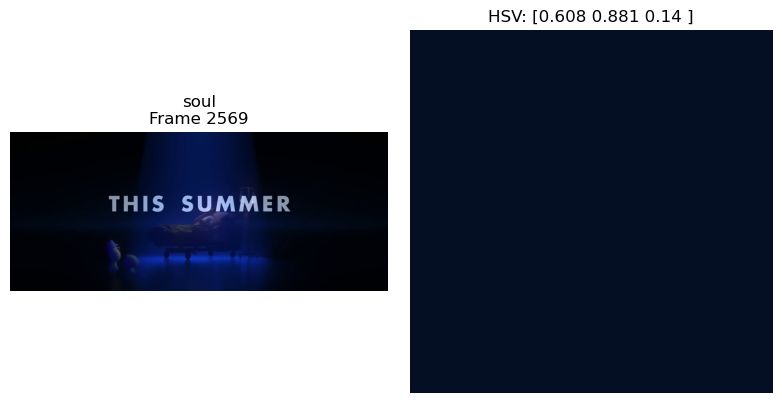

  lalaland — Frame 1740 — HSV: [0.598 0.807 0.203]


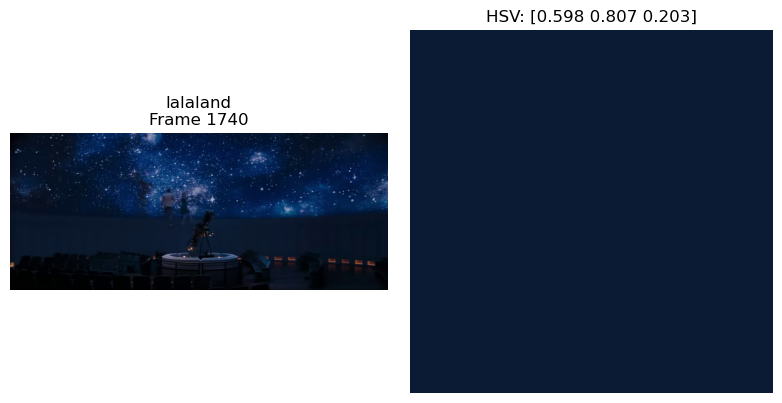


Cluster 7:
  inside out — Frame 2745 — HSV: [0.16  0.348 0.441]


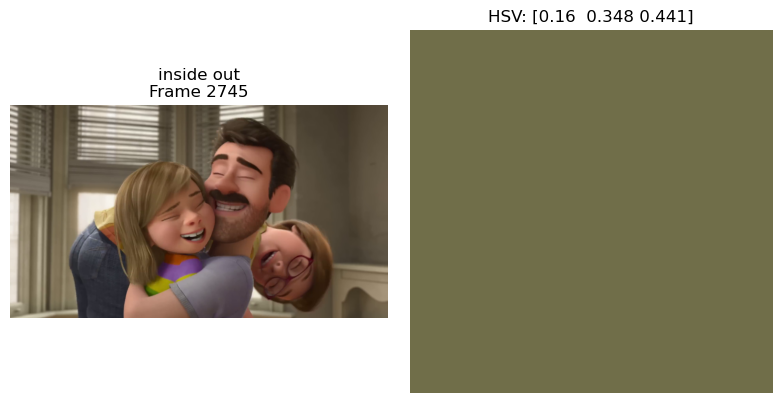

  madmax — Frame 1249 — HSV: [0.176 0.391 0.399]


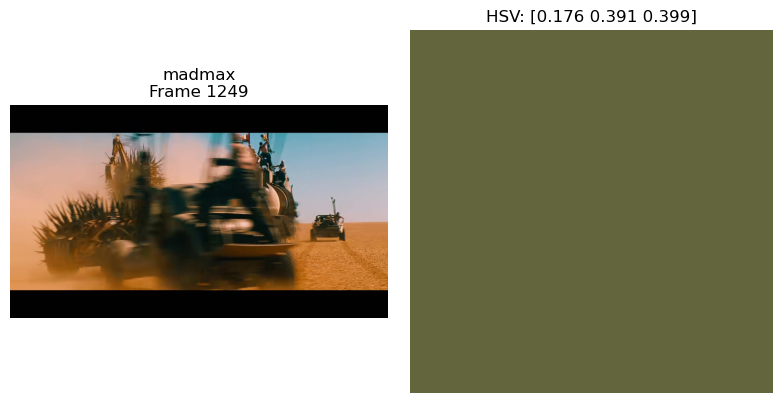

  elemental — Frame 2445 — HSV: [0.128 0.552 0.42 ]


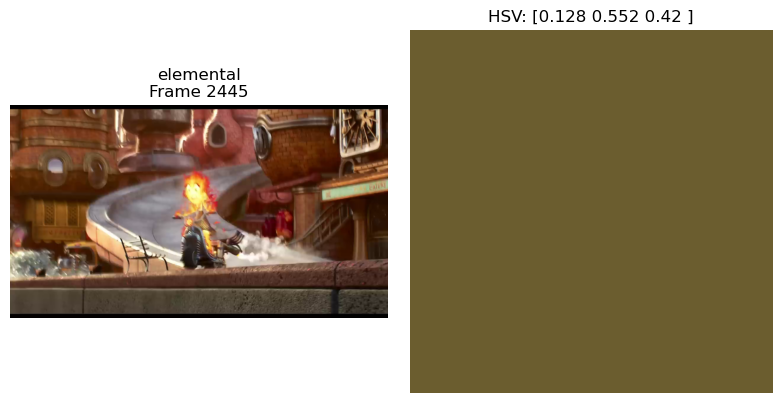

  avatar — Frame 4720 — HSV: [0.192 0.367 0.403]


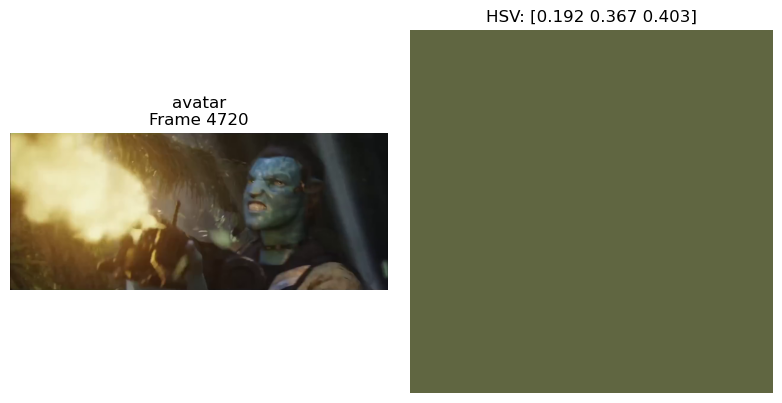

  frozen — Frame 2379 — HSV: [0.191 0.477 0.501]


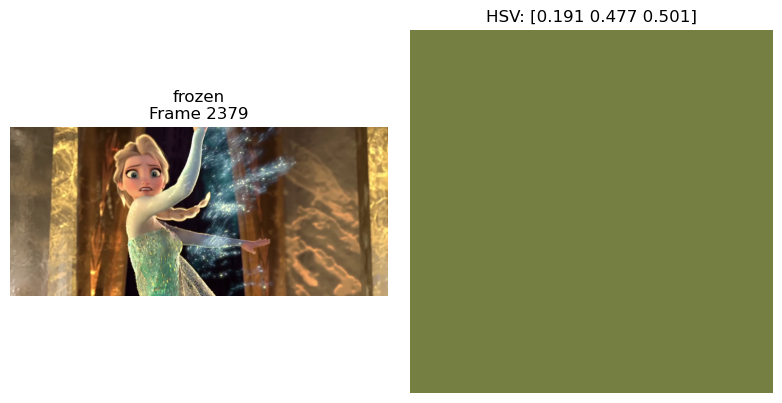

  shawshank — Frame 1193 — HSV: [0.178 0.333 0.299]


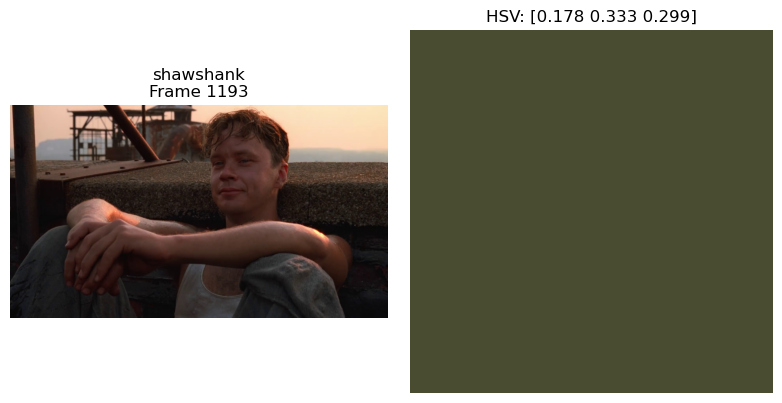

  soul — Frame 1909 — HSV: [0.221 0.361 0.429]


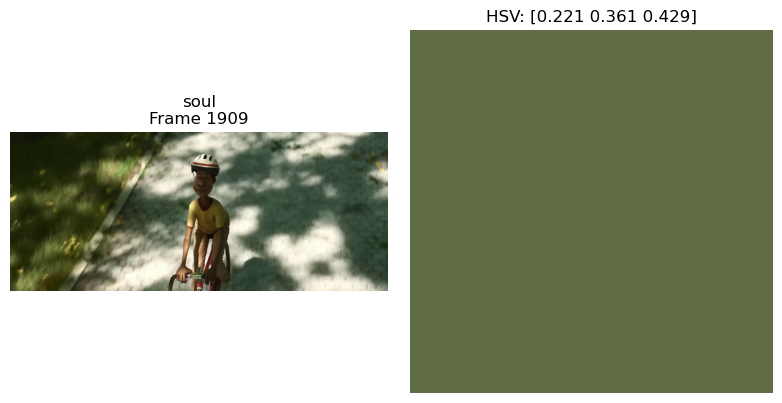

  lalaland — Frame 2893 — HSV: [0.16  0.42  0.303]


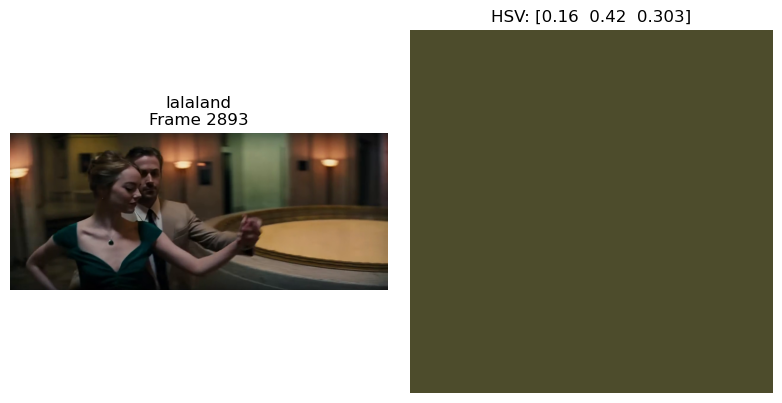


Cluster 8:
  inside out — Frame 1745 — HSV: [0.477 0.578 0.157]


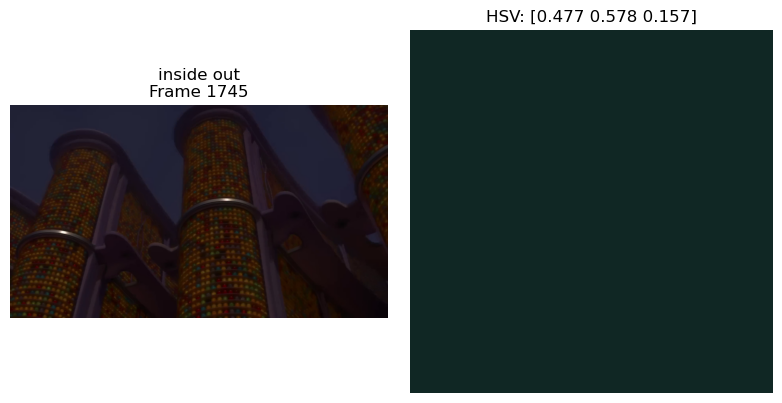

  madmax — Frame 3051 — HSV: [0.47  0.597 0.215]


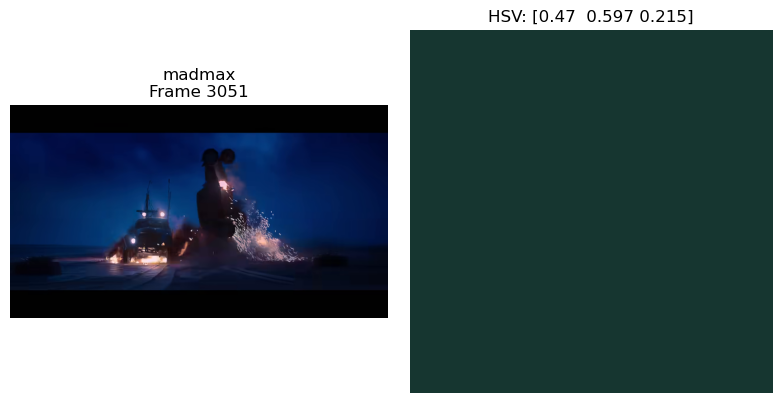

  elemental — Frame 2413 — HSV: [0.459 0.571 0.183]


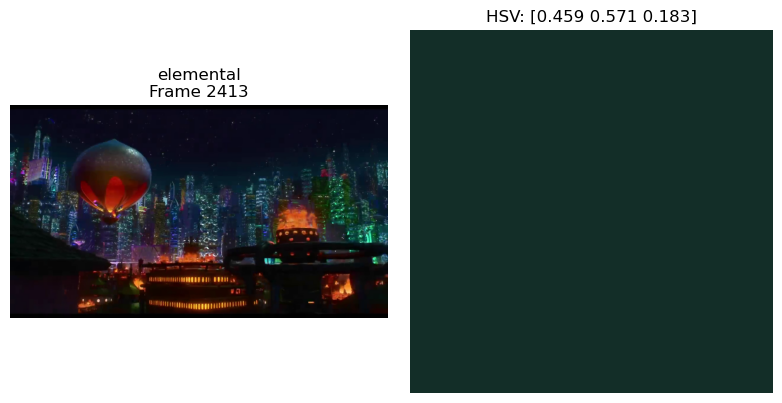

  avatar — Frame 2225 — HSV: [0.507 0.586 0.173]


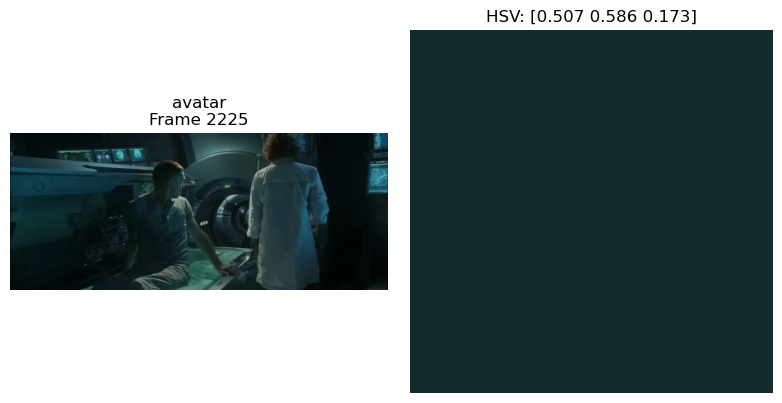

  frozen — Frame 350 — HSV: [0.523 0.535 0.158]


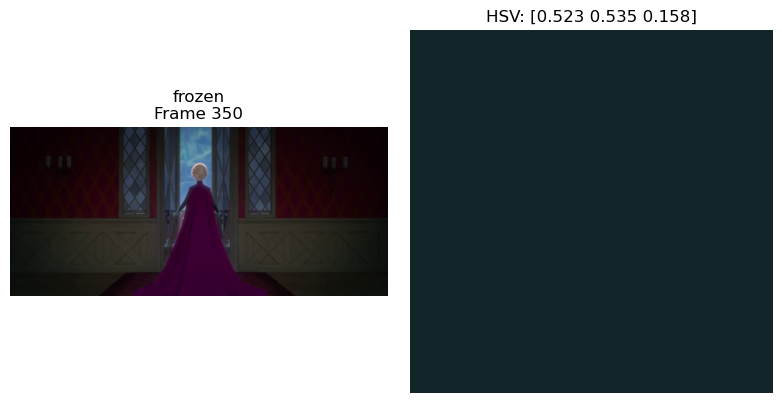

  shawshank — Frame 2269 — HSV: [0.604 0.561 0.166]


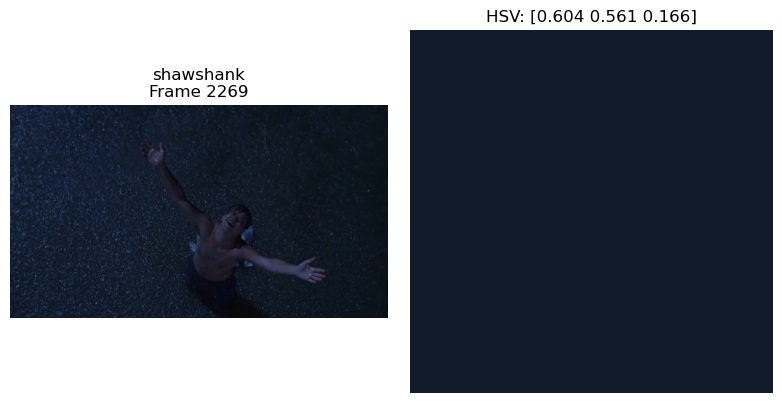

  soul — Frame 1059 — HSV: [0.506 0.577 0.15 ]


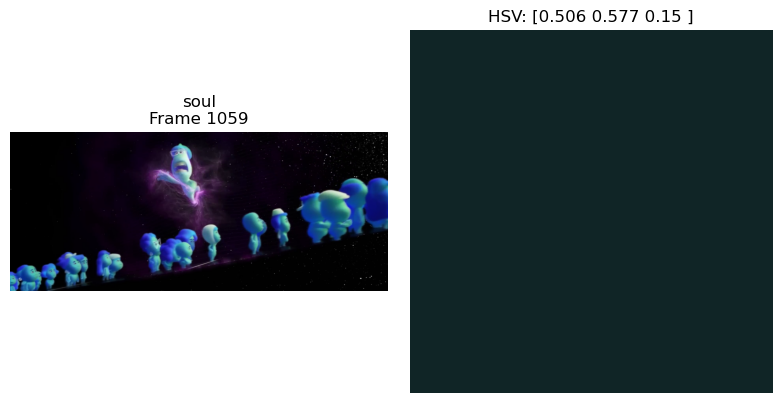

  lalaland — Frame 2744 — HSV: [0.537 0.579 0.171]


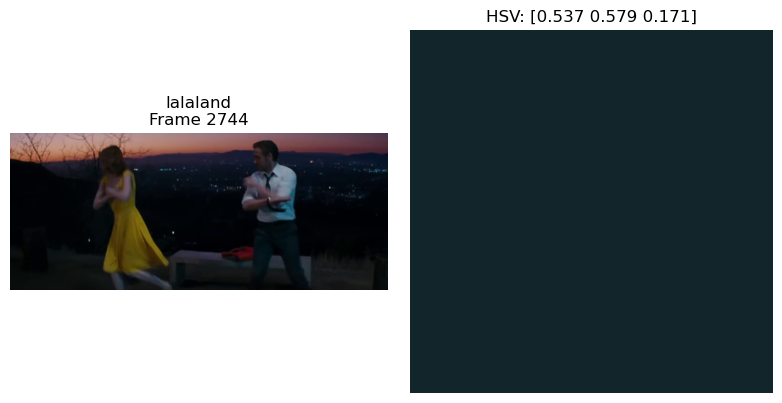


Cluster 9:
  inside out — Frame 2626 — HSV: [0.576 0.708 0.61 ]


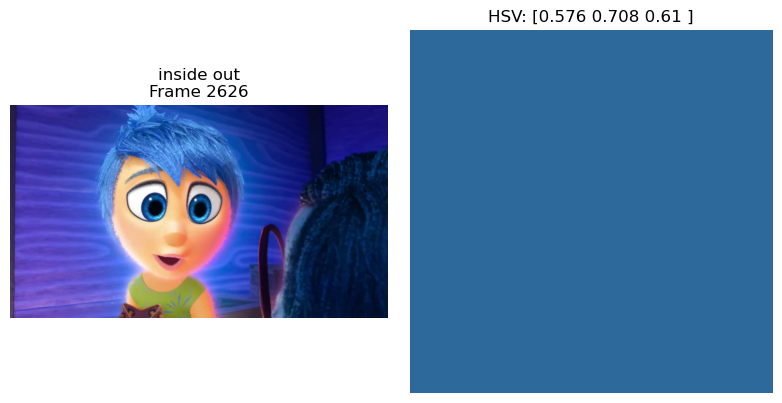

  madmax: No frames in this cluster.
  elemental — Frame 735 — HSV: [0.576 0.768 0.512]


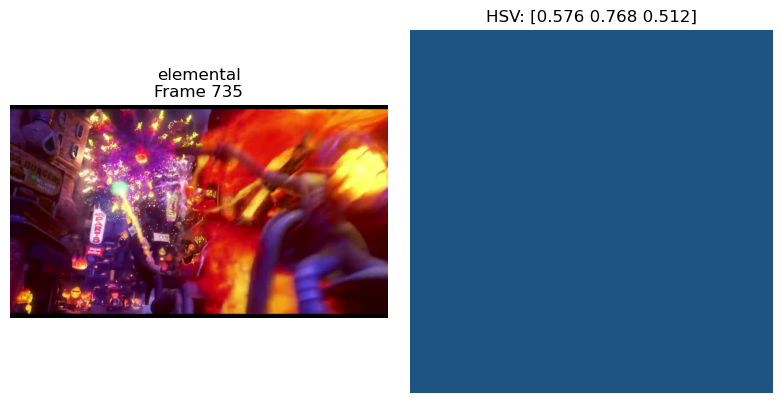

  avatar — Frame 1902 — HSV: [0.622 0.715 0.511]


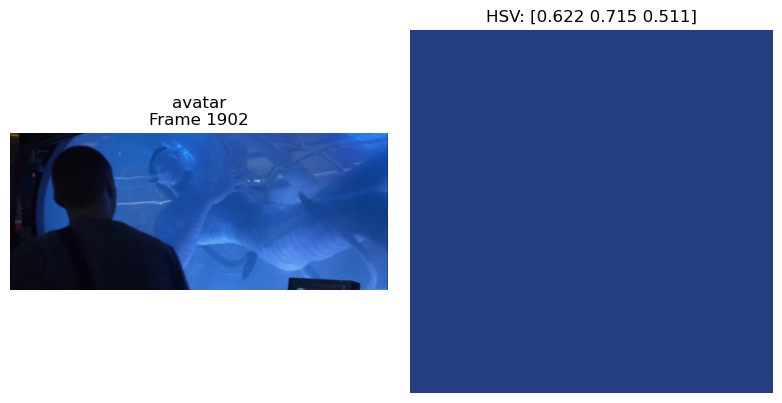

  frozen — Frame 540 — HSV: [0.618 0.783 0.548]


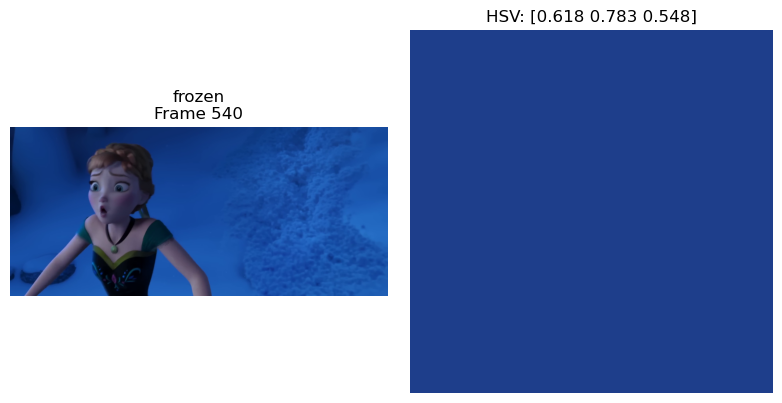

  shawshank: No frames in this cluster.
  soul — Frame 2778 — HSV: [0.634 0.782 0.585]


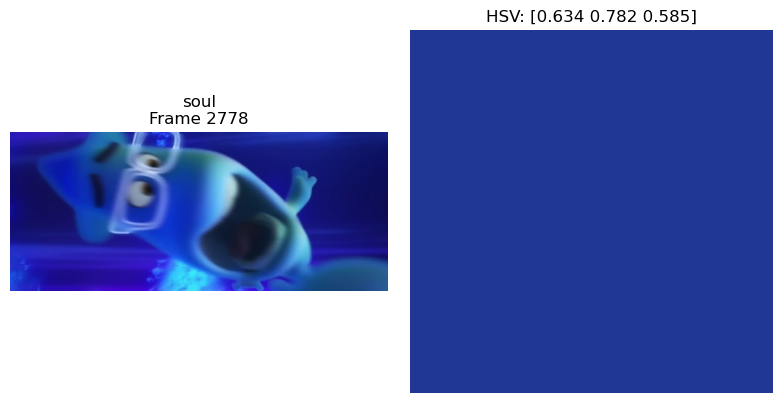

  lalaland — Frame 3149 — HSV: [0.677 0.802 0.479]


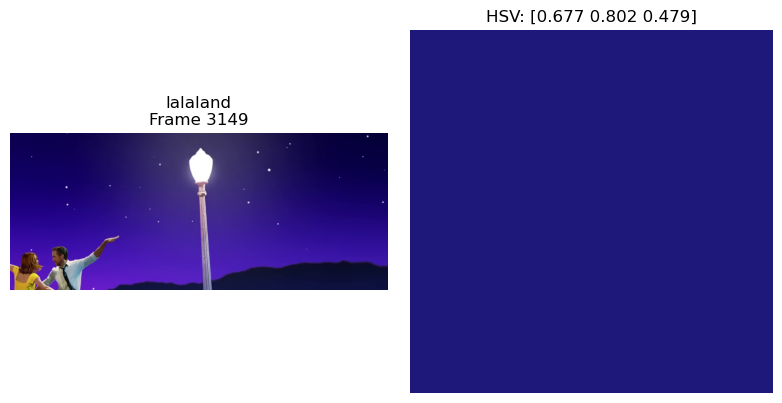


Cluster 10:
  inside out — Frame 1363 — HSV: [0.67  0.516 0.69 ]


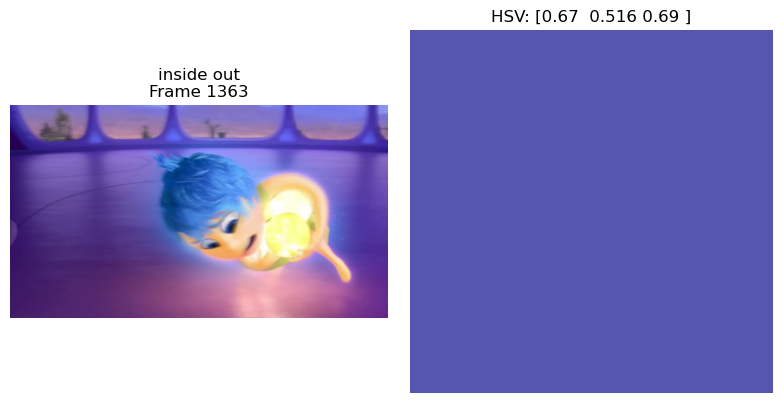

  madmax: No frames in this cluster.
  elemental — Frame 1916 — HSV: [0.665 0.488 0.679]


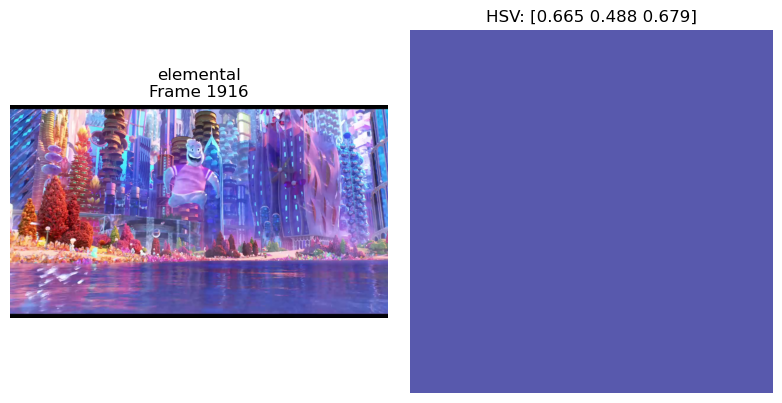

  avatar — Frame 2460 — HSV: [0.65  0.445 0.687]


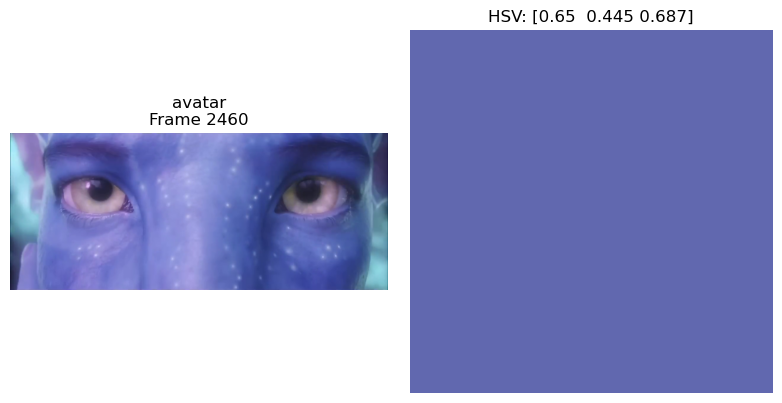

  frozen — Frame 2733 — HSV: [0.662 0.551 0.693]


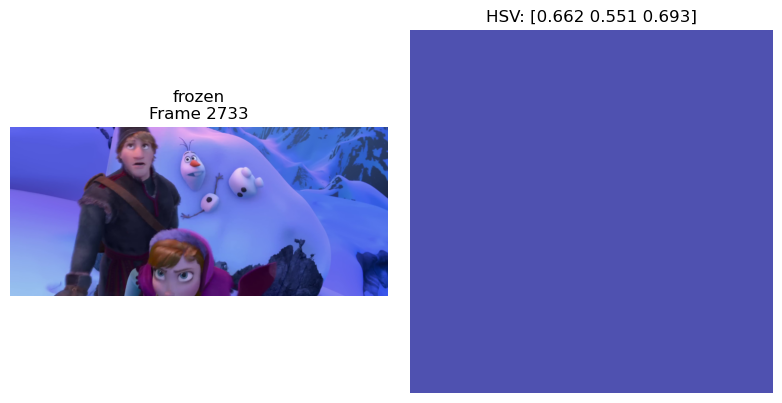

  shawshank: No frames in this cluster.
  soul — Frame 2863 — HSV: [0.615 0.56  0.692]


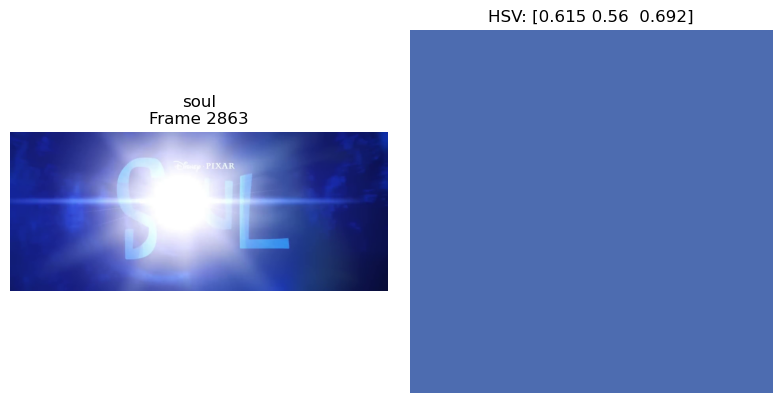

  lalaland — Frame 2660 — HSV: [0.451 0.628 0.681]


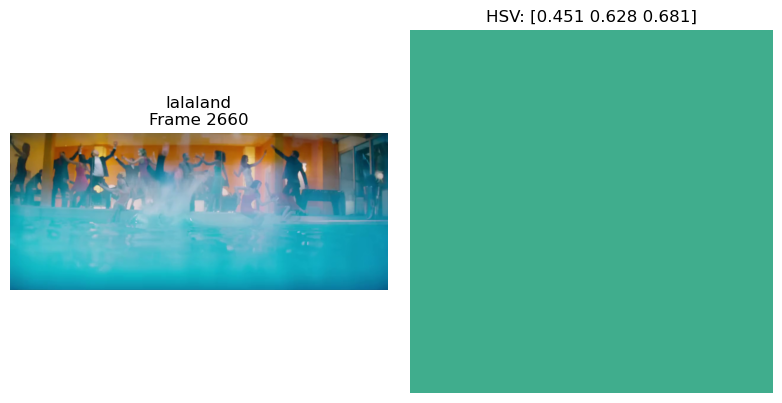


Cluster 11:
  inside out — Frame 1825 — HSV: [0.561 0.51  0.429]


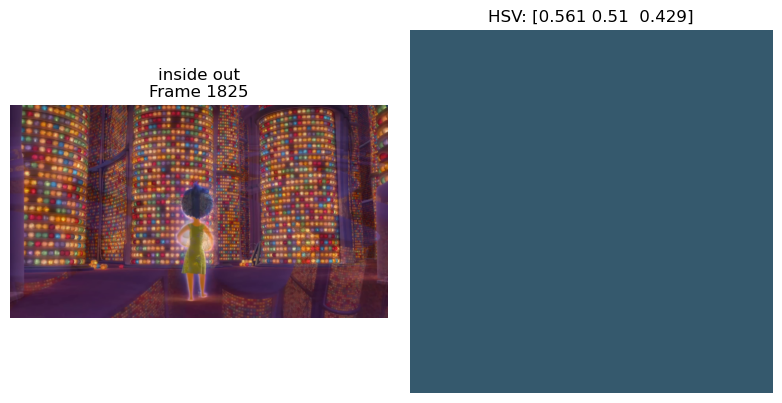

  madmax — Frame 1918 — HSV: [0.469 0.507 0.444]


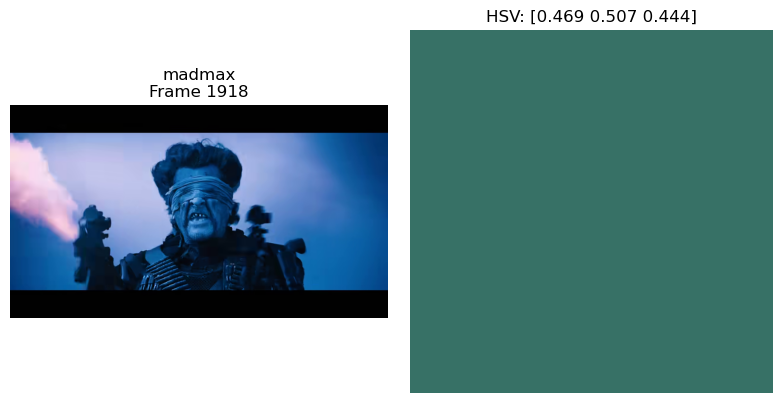

  elemental — Frame 1299 — HSV: [0.563 0.507 0.421]


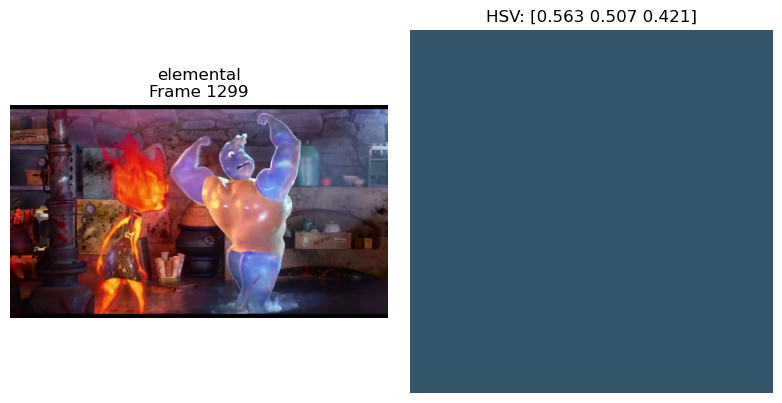

  avatar — Frame 3509 — HSV: [0.541 0.537 0.398]


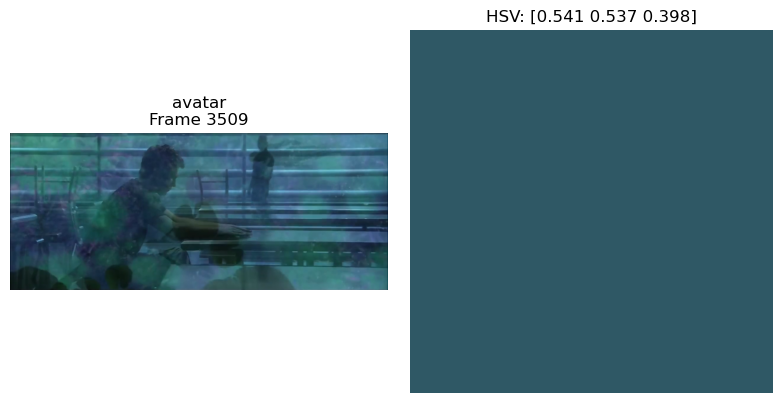

  frozen — Frame 755 — HSV: [0.552 0.536 0.455]


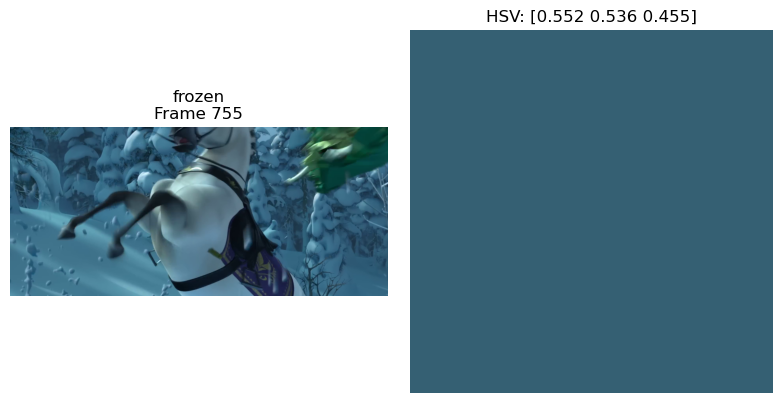

  shawshank — Frame 2252 — HSV: [0.606 0.477 0.379]


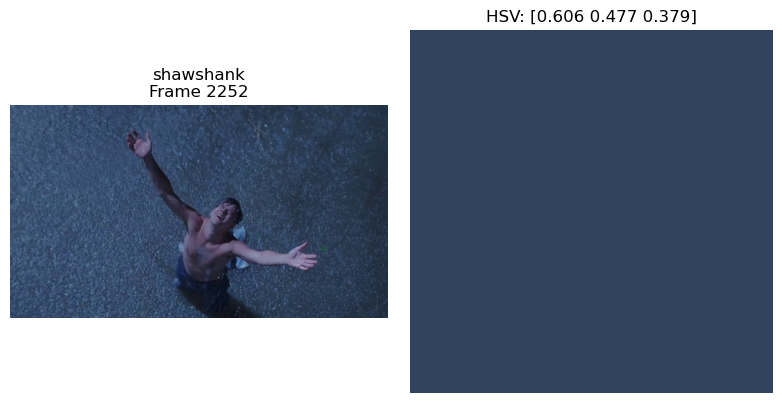

  soul — Frame 2330 — HSV: [0.613 0.58  0.385]


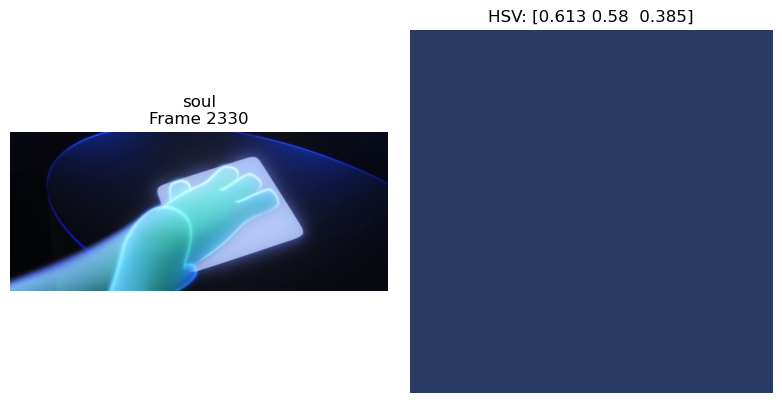

  lalaland — Frame 2103 — HSV: [0.515 0.478 0.413]


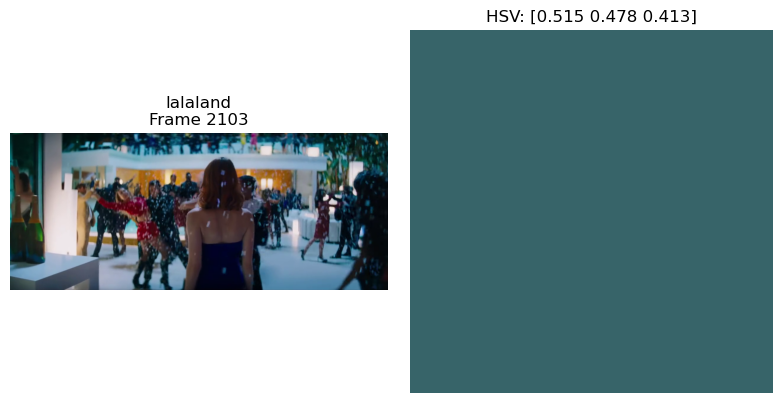

In [25]:
compare_movie_clusters(["inside out", "madmax", "elemental", "avatar", "frozen", "shawshank", "soul", "lalaland"], n_clusters=12)